# Rock Daisy Visualization Notebook

This notebook includes various visualizations of rock daisies throughout the Americas. 

# 1. Imports

In [54]:
import sys
import os

# Add the parent directory of 'rockdaisy' to the Python path
sys.path.append(os.path.abspath(".."))

In [55]:
import rockdaisy

In [56]:
import numpy as np
import pandas as pd
from rockdaisy.nomenclator import Nomenclator
from rockdaisy.plotting import plot_geographical_positions, plot_geographical_heatmap_overlay, plot_3d_relief_with_species

import pyvista as pv
import ipywidgets
import trame
pv.set_jupyter_backend('trame')  # <-- Important line

# 2. Nomenclator

In [67]:
import pandas as pd
import difflib

# === 1. Load data ===
df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')
df_full = df_full.dropna(subset=['decimalLatitude', 'decimalLongitude'])
df_full = df_full.drop_duplicates()

rock_daisy_df = pd.read_csv('../data/nomenclator.csv')

# === 2. Fuzzy match GBIF acceptedScientificName to nomenclator accepted_gbif_name ===
gbif_names = set(df_full['acceptedScientificName'].dropna().unique())
nomenclator_names = set(rock_daisy_df['accepted_gbif_name'].dropna().unique())
unmatched_gbif = list(gbif_names - nomenclator_names)

fuzzy_matches = {
    name: difflib.get_close_matches(name, nomenclator_names, n=1, cutoff=0.85)[0]
    for name in unmatched_gbif
    if difflib.get_close_matches(name, nomenclator_names, n=1, cutoff=0.85)
}

df_full['matched_name'] = df_full['acceptedScientificName'].apply(
    lambda x: fuzzy_matches.get(x, x) if pd.notnull(x) else x
)

# === 3. Merge matched rows ===
merged = df_full.merge(
    rock_daisy_df,
    how='left',
    left_on='matched_name',
    right_on='accepted_gbif_name',
    suffixes=('', '_nomenclator')
)

# === 4. Identify unmatched GBIF records ===
unmatched_df = merged[merged['accepted_gbif_name'].isnull()].copy()

# === 5. Rescue based on species matching ===
species_matches = df_full[['species']].drop_duplicates().merge(
    rock_daisy_df[['name', 'scientific_name']],
    left_on='species',
    right_on='name',
    how='left'
)
species_to_scientific = dict(zip(species_matches['species'], species_matches['scientific_name']))
unmatched_df['species_based_match'] = unmatched_df['species'].map(species_to_scientific)

# === 6. Filter successful rescues ===
rescued_matches = unmatched_df[unmatched_df['species_based_match'].notnull()]

# === Optional: Summary ===
print(f"Total GBIF records: {len(df_full)}")
print(f"Successful fuzzy matches: {merged['accepted_gbif_name'].notnull().sum()}")
print(f"Rescued via species name: {rescued_matches.shape[0]}")
print(f"Remaining unmatched: {unmatched_df['species_based_match'].isnull().sum()}")


Total GBIF records: 6096
Successful fuzzy matches: 5579
Rescued via species name: 714
Remaining unmatched: 659


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_89474/3139608804.py:5: DtypeWarning: Columns (83,125,136,141,142,145,147,148,151,153,154,156,157,158,161,164,165,166,167,168,171,172,174,175,177,178,179,181,182,183) have mixed types. Specify dtype option on import or set low_memory=False.
  df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')


In [70]:
unmatched_df = unmatched_df[unmatched_df['species_based_match'].isnull()][['key', 'genus', 'species', 'acceptedScientificName', 'scientificName', 'decimalLatitude', 'decimalLongitude']]

In [71]:
unmatched_df.species.unique()

array(['Laphamia emoryi', 'Galinsogeopsis spilanthoides',
       'Laphamia gilensis', 'Laphamia bisetosa', 'Laphamia megalocephala',
       'Laphamia rupestris', 'Perityle cuneata', 'Perityle crassifolia'],
      dtype=object)

In [72]:
unmatched_df.acceptedScientificName.unique()

array(['Laphamia emoryi (Torr.) Benth. & Hook.fil.',
       'Galinsogeopsis spilanthoides var. saxosa (Brandegee) Lichter-Marck',
       'Laphamia gilensis M.E.Jones', 'Perityle gilensis var. gilensis',
       'Laphamia gilensis var. salensis (A.M.Powell) Lichter-Marck',
       'Laphamia bisetosa Torr. ex A.Gray',
       'Perityle bisetosa var. bisetosa',
       'Laphamia bisetosa var. spathulata (A.M.Powell) Lichter-Marck',
       'Laphamia megalocephala S.Watson',
       'Perityle megalocephala var. megalocephala',
       'Laphamia megalocephala var. oligophylla (A.M.Powell) Lichter-Marck',
       'Laphamia megalocephala var. megalocephala',
       'Laphamia rupestris var. albiflora (A.M.Powell) Lichter-Marck',
       'Perityle rupestris var. rupestris', 'Laphamia rupestris A.Gray',
       'Perityle cuneata var. marginata (Rydb.) I.M.Johnst.',
       'Perityle cuneata var. cuneata', 'Perityle crassifolia Brandegee',
       'Perityle crassifolia var. robusta (Rydb.) Everly',
       'P

In [65]:
import pandas as pd
import difflib

# Load the GBIF and nomenclator dataframes
df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')
df_full = df_full.dropna(subset=['decimalLatitude', 'decimalLongitude'])
df_full = df_full.drop_duplicates()

rock_daisy_df = pd.read_csv('../data/nomenclator.csv')

# Drop nulls and get sets of accepted names
gbif_names = set(df_full['acceptedScientificName'].dropna().unique())
nomenclator_names = set(rock_daisy_df['accepted_gbif_name'].dropna().unique())

# Find GBIF names not in nomenclator
unmatched_gbif = list(gbif_names - nomenclator_names)

# Fuzzy match: find best match in nomenclator for each unmatched GBIF name
fuzzy_matches = {}
for name in unmatched_gbif:
    match = difflib.get_close_matches(name, nomenclator_names, n=1, cutoff=0.85)
    if match:
        fuzzy_matches[name] = match[0]

# Create a new column with the best matched name (or keep original if already matched)
df_full['matched_name'] = df_full['acceptedScientificName'].apply(
    lambda x: fuzzy_matches.get(x, x) if pd.notnull(x) else x
)

# Merge GBIF data with nomenclator on matched name
merged = df_full.merge(
    rock_daisy_df,
    how='left',
    left_on='matched_name',
    right_on='accepted_gbif_name',
    suffixes=('', '_nomenclator')
)

# DataFrame of unmatched GBIF records
unmatched_df = merged[merged['accepted_gbif_name'].isnull()]

# Optional: only keep successful matches
matched_df = merged[merged['accepted_gbif_name'].notnull()]

# Count of total records and matched ones
total_records = len(df_full)
successful_matches = matched_df.shape[0]
unsuccessful_matches = total_records - successful_matches

print(f"✅ Total GBIF records: {total_records}")
print(f"✅ Successfully matched to nomenclator: {successful_matches}")
print(f"❌ Unmatched records: {unsuccessful_matches}")

matched_df.head()


Total GBIF records: 8724
Successful fuzzy matches: 7609
Rescued via species name: 1048
Remaining unmatched: 1095


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_89474/3802099376.py:5: DtypeWarning: Columns (83,125,136,141,142,145,147,148,151,153,154,156,157,158,161,164,165,166,167,168,171,172,174,175,177,178,179,181,182,183) have mixed types. Specify dtype option on import or set low_memory=False.
  df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')


In [63]:
unmatched_df[['key', 'genus', 'species', 'acceptedScientificName', 'scientificName', 'decimalLatitude', 'decimalLongitude']]

,key,genus,species,acceptedScientificName,scientificName,decimalLatitude,decimalLongitude
526,5007772121,Laphamia,Laphamia emoryi,Laphamia emoryi (Torr.) Benth. & Hook.fil.,Perityle emoryi Torr.,33.374679,-116.430717
527,5007836670,Laphamia,Laphamia emoryi,Laphamia emoryi (Torr.) Benth. & Hook.fil.,Perityle emoryi Torr.,33.002425,-116.442313
528,5006974529,Laphamia,Laphamia emoryi,Laphamia emoryi (Torr.) Benth. & Hook.fil.,Perityle emoryi Torr.,32.087092,-116.826000
529,5087149889,Laphamia,Laphamia emoryi,Laphamia emoryi (Torr.) Benth. & Hook.fil.,Perityle emoryi Torr.,33.636906,-116.071211
530,5063275171,Laphamia,Laphamia emoryi,Laphamia emoryi (Torr.) Benth. & Hook.fil.,Perityle emoryi Torr.,33.001747,-116.442895
...,...,...,...,...,...,...,...
6535,1259881790,Perityle,Perityle greenei,Perityle greenei Rose,Perityle greenei Rose,23.880000,-109.910000
6536,1259880630,Perityle,Perityle greenei,Perityle greenei Rose,Perityle greenei Rose,25.983333,-111.916667
6537,1259879922,Perityle,Perityle greenei,Perityle greenei Rose,Perityle greenei Rose,27.866667,-115.166667
6538,1259881332,Perityle,Perityle greenei,Perityle greenei Rose,Perityle greenei Rose,28.316667,-115.583333


In [48]:
df_full = matched_df.copy()

columns = ['key', 'genus', 'species', 'acceptedScientificName', 'scientificName', 'decimalLatitude', 'decimalLongitude','matched_name', 'name', 'scientific_name', 'genus_nomenclator', 'species_nomenclator', 'authors', 'accepted_name', 'accepted_authors', 'relationship', 'variety', 'variety_original_author', 'variety_combination_author', 'gbif_scientific_name', 'accepted_gbif_name']
df_full = df_full[columns]

In [53]:
df_full = df_full.dropna(subset=['decimalLatitude', 'decimalLongitude'])
df_full = df_full.drop_duplicates()

,key,genus,species,acceptedScientificName,scientificName,decimalLatitude,decimalLongitude,matched_name,name,scientific_name,...,species_nomenclator,authors,accepted_name,accepted_authors,relationship,variety,variety_original_author,variety_combination_author,gbif_scientific_name,accepted_gbif_name
0,3764504470,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,-26.345373,-79.892358,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,...,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted,NaN,NaN,NaN,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
1,3455569773,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,-26.346620,-79.886282,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,...,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted,NaN,NaN,NaN,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
3,3125266488,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,-26.350000,-79.866670,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,...,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted,NaN,NaN,NaN,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
18,3125101517,Perityle,Perityle brandegeeana,Perityle brandegeeana Rose,Amauria brandegeeana (Rose) Rydb.,24.789640,-112.263890,Perityle brandegeeana Rose,Perityle brandegeeana,Perityle brandegeeana Rose,...,brandegeeana,Rose,Perityle brandegeeana,Rose,accepted,NaN,NaN,NaN,Perityle brandegeeana Rose,Perityle brandegeeana Rose
19,3125106522,Perityle,Perityle brandegeeana,Perityle brandegeeana Rose,Amauria brandegeeana (Rose) Rydb.,28.252860,-114.091560,Perityle brandegeeana Rose,Perityle brandegeeana,Perityle brandegeeana Rose,...,brandegeeana,Rose,Perityle brandegeeana,Rose,accepted,NaN,NaN,NaN,Perityle brandegeeana Rose,Perityle brandegeeana Rose
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9744,2629736014,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,18.948889,-97.229444,Villanova achilleoides (Kunth) Less.,Villanova achilleoides,Villanova achilleoides (Less.) Less,...,achilleoides,(Less.) Less,Villanova anemonifolia,(Kunth) Less.,synonym,NaN,NaN,NaN,Villanova achilleoides (Less.) Less,Villanova achilleoides (Kunth) Less.
9745,5101849029,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,18.949569,-97.229713,Villanova achilleoides (Kunth) Less.,Villanova achilleoides,Villanova achilleoides (Less.) Less,...,achilleoides,(Less.) Less,Villanova anemonifolia,(Kunth) Less.,synonym,NaN,NaN,NaN,Villanova achilleoides (Less.) Less,Villanova achilleoides (Kunth) Less.
9747,2629576867,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,18.948889,-97.229444,Villanova achilleoides (Kunth) Less.,Villanova achilleoides,Villanova achilleoides (Less.) Less,...,achilleoides,(Less.) Less,Villanova anemonifolia,(Kunth) Less.,synonym,NaN,NaN,NaN,Villanova achilleoides (Less.) Less,Villanova achilleoides (Kunth) Less.
9750,4165582317,Villanova,Villanova robusta,Villanova robusta Phil.,Villanova robusta Phil.,-19.185061,-69.342125,Villanova robusta Phil.,Villanova robusta,Villanova robusta Phil.,...,robusta,Phil.,Villanova robusta,Phil.,accepted,NaN,NaN,NaN,Villanova robusta Phil.,Villanova robusta Phil.


In [52]:
df_full

,key,genus,species,acceptedScientificName,scientificName,decimalLatitude,decimalLongitude,matched_name,name,scientific_name,...,species_nomenclator,authors,accepted_name,accepted_authors,relationship,variety,variety_original_author,variety_combination_author,gbif_scientific_name,accepted_gbif_name
0,3764504470,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,-26.345373,-79.892358,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,...,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted,NaN,NaN,NaN,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
1,3455569773,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,-26.346620,-79.886282,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,...,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted,NaN,NaN,NaN,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
3,3125266488,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,-26.350000,-79.866670,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,...,tenuifolius,(Phil.) I.H. Lichter-Marck,Perityle tenuifolius,(Phil.) I.H. Lichter-Marck,accepted,NaN,NaN,NaN,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
18,3125101517,Perityle,Perityle brandegeeana,Perityle brandegeeana Rose,Amauria brandegeeana (Rose) Rydb.,24.789640,-112.263890,Perityle brandegeeana Rose,Perityle brandegeeana,Perityle brandegeeana Rose,...,brandegeeana,Rose,Perityle brandegeeana,Rose,accepted,NaN,NaN,NaN,Perityle brandegeeana Rose,Perityle brandegeeana Rose
19,3125106522,Perityle,Perityle brandegeeana,Perityle brandegeeana Rose,Amauria brandegeeana (Rose) Rydb.,28.252860,-114.091560,Perityle brandegeeana Rose,Perityle brandegeeana,Perityle brandegeeana Rose,...,brandegeeana,Rose,Perityle brandegeeana,Rose,accepted,NaN,NaN,NaN,Perityle brandegeeana Rose,Perityle brandegeeana Rose
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9744,2629736014,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,18.948889,-97.229444,Villanova achilleoides (Kunth) Less.,Villanova achilleoides,Villanova achilleoides (Less.) Less,...,achilleoides,(Less.) Less,Villanova anemonifolia,(Kunth) Less.,synonym,NaN,NaN,NaN,Villanova achilleoides (Less.) Less,Villanova achilleoides (Kunth) Less.
9745,5101849029,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,18.949569,-97.229713,Villanova achilleoides (Kunth) Less.,Villanova achilleoides,Villanova achilleoides (Less.) Less,...,achilleoides,(Less.) Less,Villanova anemonifolia,(Kunth) Less.,synonym,NaN,NaN,NaN,Villanova achilleoides (Less.) Less,Villanova achilleoides (Kunth) Less.
9747,2629576867,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,18.948889,-97.229444,Villanova achilleoides (Kunth) Less.,Villanova achilleoides,Villanova achilleoides (Less.) Less,...,achilleoides,(Less.) Less,Villanova anemonifolia,(Kunth) Less.,synonym,NaN,NaN,NaN,Villanova achilleoides (Less.) Less,Villanova achilleoides (Kunth) Less.
9750,4165582317,Villanova,Villanova robusta,Villanova robusta Phil.,Villanova robusta Phil.,-19.185061,-69.342125,Villanova robusta Phil.,Villanova robusta,Villanova robusta Phil.,...,robusta,Phil.,Villanova robusta,Phil.,accepted,NaN,NaN,NaN,Villanova robusta Phil.,Villanova robusta Phil.


###  List of Rock Daisy Genera 
- Perityle
- Galinsogeopsis
- Pericome
- eutetras
- Nesothamnus
- Laphamia
- Galeana
- Villanova

# 3. Rock Daisy Collections Data

In [10]:
api_key = '9c4fff68-2c4d-4d2c-acee-e27624fbc741'

In [11]:
df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')

/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_89474/3406933072.py:1: DtypeWarning: Columns (83,125,136,141,142,145,147,148,151,153,154,156,157,158,161,164,165,166,167,168,171,172,174,175,177,178,179,181,182,183) have mixed types. Specify dtype option on import or set low_memory=False.
  df_full = pd.read_csv('../data/gbif/gbif_occurrences.csv')


In [12]:
df_full

,key,datasetKey,publishingOrgKey,installationKey,hostingOrganizationKey,publishingCountry,protocol,lastCrawled,lastParsed,crawlId,...,organismName,verbatimIdentification,organismQuantity,organismQuantityType,waterBody,island,coordinatePrecision,samplingEffort,parentEventID,acceptedNameUsageID
0,3764504470,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,28eb1a3f-1c15-4a95-931a-4af90ecb574d,CL,DWC_ARCHIVE,2025-05-08T21:36:07.572+00:00,2025-05-12T14:28:36.026+00:00,542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3455569773,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,28eb1a3f-1c15-4a95-931a-4af90ecb574d,CL,DWC_ARCHIVE,2025-05-08T21:36:07.572+00:00,2025-05-12T12:05:49.961+00:00,542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1456004768,821cc27a-e3bb-4bc5-ac34-89ada245069d,bc092ff0-02e4-11dc-991f-b8a03c50a862,b2ff19b5-d74f-40d2-82f1-ec5db01e8e31,bc092ff0-02e4-11dc-991f-b8a03c50a862,US,EML,2025-05-02T11:18:50.636+00:00,2025-05-02T13:21:15.208+00:00,448,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3125266488,9b7d1acf-b22f-4a1f-b6e8-f1ddd744dc07,8a471700-4ce8-11db-b80e-b8a03c50a862,cb27a4ab-3360-4cf5-b5de-48a06a9c47ae,96710dc8-fecb-440d-ae3e-c34ae8a9616f,US,DWC_ARCHIVE,2025-05-09T15:48:15.665+00:00,2025-05-09T16:01:03.401+00:00,307,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1096722507,0943f690-fde5-11dd-83f4-b8a03c50a862,6ba9a8cc-513a-4a51-bf93-6f5de8040a96,4346b227-ca68-4d54-8a77-909148492e0b,4c415e40-1e21-11de-9e40-a0d6ecebb8bf,SE,EML,2025-01-21T14:10:51.862+00:00,2025-02-06T17:56:31.809+00:00,323,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8719,2629576867,98c51784-da02-4f0e-81a4-f3635cb3cba7,ff90b050-c256-11db-b71b-b8a03c50a862,e081c7d7-2dab-42fd-94c4-9f275767fe7d,ff90b050-c256-11db-b71b-b8a03c50a862,MX,EML,2025-04-09T06:16:51.208+00:00,2025-04-09T06:33:39.060+00:00,249,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8720,1456233227,821cc27a-e3bb-4bc5-ac34-89ada245069d,bc092ff0-02e4-11dc-991f-b8a03c50a862,b2ff19b5-d74f-40d2-82f1-ec5db01e8e31,bc092ff0-02e4-11dc-991f-b8a03c50a862,US,EML,2025-05-02T11:18:50.636+00:00,2025-05-02T13:37:28.883+00:00,448,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8721,3346235279,d8cd16ba-bb74-4420-821e-083f2bac17c2,ada9d123-ddb4-467d-8891-806ea8d94230,17a83780-3060-4851-9d6f-029d5fcb81c9,fbca90e3-8aed-48b1-84e3-369afbd000ce,GB,EML,2025-05-10T12:04:02.898+00:00,2025-05-10T12:26:11.953+00:00,218,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8722,4165582317,50c9509d-22c7-4a22-a47d-8c48425ef4a7,28eb1a3f-1c15-4a95-931a-4af90ecb574d,997448a8-f762-11e1-a439-00145eb45e9a,28eb1a3f-1c15-4a95-931a-4af90ecb574d,US,DWC_ARCHIVE,2025-05-08T21:36:07.572+00:00,2025-05-12T11:40:03.461+00:00,542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
list(df_full.columns)

['key',
 'datasetKey',
 'publishingOrgKey',
 'installationKey',
 'hostingOrganizationKey',
 'publishingCountry',
 'protocol',
 'lastCrawled',
 'lastParsed',
 'crawlId',
 'extensions',
 'basisOfRecord',
 'occurrenceStatus',
 'taxonKey',
 'kingdomKey',
 'phylumKey',
 'classKey',
 'orderKey',
 'familyKey',
 'genusKey',
 'speciesKey',
 'acceptedTaxonKey',
 'scientificName',
 'acceptedScientificName',
 'kingdom',
 'phylum',
 'order',
 'family',
 'genus',
 'species',
 'genericName',
 'specificEpithet',
 'taxonRank',
 'taxonomicStatus',
 'iucnRedListCategory',
 'dateIdentified',
 'decimalLatitude',
 'decimalLongitude',
 'continent',
 'stateProvince',
 'gadm',
 'year',
 'month',
 'day',
 'eventDate',
 'startDayOfYear',
 'endDayOfYear',
 'issues',
 'modified',
 'lastInterpreted',
 'references',
 'license',
 'isSequenced',
 'identifiers',
 'media',
 'facts',
 'relations',
 'isInCluster',
 'datasetName',
 'recordedBy',
 'identifiedBy',
 'dnaSequenceID',
 'geodeticDatum',
 'class',
 'countryCode',

In [14]:
col_l = ['key', 'occurrenceStatus', 'taxonKey', 'kingdomKey', 'phylumKey', 'classKey', 'orderKey', 'familyKey',
         'genusKey', 'speciesKey', 'acceptedTaxonKey', 'scientificName', 'acceptedScientificName', 'kingdom',
         'phylum', 'order', 'family', 'genus', 'species', 'genericName', 'specificEpithet', 'dateIdentified',
         'decimalLatitude', 'decimalLongitude', 'continent', 'stateProvince','locality', 'collectionID',
         'higherClassification', 'elevation', 'sex', 'coordinateUncertaintyInMeters', 'elevationAccuracy',
         'fieldNotes', 'locationRemarks', 'eventRemarks','organismName', 'verbatimIdentification',
         'organismQuantity', 'organismQuantityType', ]

In [15]:
df_full = df_full[col_l]

In [16]:
df_full

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,sex,coordinateUncertaintyInMeters,elevationAccuracy,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType
0,3764504470,PRESENT,12262613,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3455569773,PRESENT,12262613,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1456004768,PRESENT,3096495,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3125266488,PRESENT,3096495,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1096722507,PRESENT,3096495,6,7707728,220,414,3065,3146354,12262613.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8719,2629576867,PRESENT,6064470,6,7707728,220,414,3065,5939836,6064470.0,...,NaN,90.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8720,1456233227,PRESENT,4255482,6,7707728,220,414,3065,5939836,6064470.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8721,3346235279,PRESENT,6064470,6,7707728,220,414,3065,5939836,6064470.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8722,4165582317,PRESENT,5939838,6,7707728,220,414,3065,5939836,5939838.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


And now lets check for duplicates

In [17]:

print(len(df_full) - len(df_full.drop_duplicates()), 'duplicates detected')

df_full = df_full.drop_duplicates().reset_index(drop=True)

2604 duplicates detected


In [26]:
df_full[['genus', 'species', 'acceptedScientificName', 'scientificName', 'genericName']]

,genus,species,acceptedScientificName,scientificName,genericName
0,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle
1,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle
2,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,Lycapsus
3,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,Lycapsus
4,Perityle,Perityle tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Lycapsus tenuifolius Phil.,Lycapsus
...,...,...,...,...,...
6115,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,Villanova
6116,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Vasquezia achilleoides (Less.) Rydb.,Vasquezia
6117,Villanova,Villanova achilleoides,Villanova achilleoides (Less.) Less.,Villanova achilleoides (Less.) Less.,Villanova
6118,Villanova,Villanova robusta,Villanova robusta Phil.,Villanova robusta Phil.,Villanova


In [21]:
accepted_df[['genus', 'name', 'species', 'accepted_gbif_name', 'scientific_name', 'gbif_scientific_name']]

,genus,name,species,accepted_gbif_name,scientific_name,gbif_scientific_name
1,Perityle,Perityle tenuifolius,tenuifolius,Perityle tenuifolius (Phil.) Lichter-Marck,Perityle tenuifolius (Phil.) I.H. Lichter-Marck,Perityle tenuifolius (Phil.) Lichter-Marck
3,Perityle,Perityle brandegeeana,brandegeeana,Perityle brandegeeana Rose,Perityle brandegeeana Rose,Perityle brandegeeana Rose
5,Perityle,Perityle carterae,carterae,Perityle carterae (Powell) Lichter-Marck,Perityle carterae (A.M. Powell) I.H. Lichter-M...,Perityle carterae (Powell) Lichter-Marck
7,Perityle,Perityle rotundifolia,rotundifolia,Perityle rotundifolia (Benth.) Brandegee,Perityle rotundifolia (Benth.) T.S. Brandegee,Perityle rotundifolia (Benth.) Brandegee
9,Galeana,Galeana pratensis,pratensis,Galeana pratensis (Kunth) Rydb.,Galeana pratensis (Kunth) Rydb.,Galeana pratensis (Kunth) Rydb.
...,...,...,...,...,...,...
244,Perityle,Perityle socorrosensis,socorrosensis,Perityle socorrosensis Rose,Perityle socorrosensis Rose,Perityle socorrosensis Rose
245,Perityle,Perityle trichodonta,trichodonta,Perityle trichodonta Blake,Perityle trichodonta S.F. Blake,Perityle trichodonta Blake
250,Villanova,Villanova oppositifolia,oppositifolia,Villanova oppositifolia Lag.,Villanova oppositifolia Lag.,Villanova oppositifolia Lag.
252,Villanova,Villanova titicacaensis,titicacaensis,Villanova titicacaensis (Walp.) Walp.,Villanova titicacaensis (Meyen & Walp.) Walp.,Villanova titicacaensis (Walp.) Walp.


In [25]:
print('GBIF pull species that are not in the nomenclator:', list(set(df_full.acceptedScientificName) - set(rock_daisy_df.accepted_gbif_name)))

print('Nomenclator accepted species that are not in gbif pull:', list(set(rock_daisy_df.accepted_gbif_name) - set(df_full.acceptedScientificName)))

GBIF pull species that are not in the nomenclator: ['Laphamia bisetosa var. scalaris (A.M.Powell) Lichter-Marck', 'Galinsogeopsis ciliata (L.H.Dewey) Lichter-Marck', 'Laphamia lindheimeri A.Gray', 'Galinsogeopsis coronopifolia (A.Gray) Lichter-Marck', 'Laphamia lemmonii A.Gray', 'Laphamia reinana (B.L.Turner) Lichter-Marck', 'Perityle cuneata Brandegee', 'Galinsogeopsis turneri (A.M.Powell) Lichter-Marck', 'Laphamia vandevenderi (B.L.Turner) Lichter-Marck', 'Laphamia ambrosiifolia (Greene ex A.M.Powell & Yarb.) Lichter-Marck', 'Laphamia megalocephala var. oligophylla (A.M.Powell) Lichter-Marck', 'Laphamia warnockii (A.M.Powell) Lichter-Marck', 'Perityle alamosana B.L.Turner', 'Laphamia dissecta Torr.', 'Laphamia lloydii (B.L.Rob. & Fernald) Lichter-Marck', 'Laphamia huecoensis (A.M.Powell) Lichter-Marck', 'Villanova titicacensis (Meyen & Walp.) Walp.', 'Laphamia fosteri (A.M.Powell) Lichter-Marck', 'Perityle greenei Rose', 'Eutetras pringlei Greenm.', 'Galeana hastata LaLlave', 'Galins

In [ ]:
print('GBIF pull species that are not in the nomenclator:', list(set(df_full.species) - set(nomenclator_df.all_names())))

print('Nomenclator accepted species that are not in gbif pull:', list(set(nomenclator.accepted_with_synonyms().keys()) - set(df_full.species)))

In [20]:
df_full[df_full.species == 'Laphamia emoryi']

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,sex,coordinateUncertaintyInMeters,elevationAccuracy,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType
562,1228545052,PRESENT,5404766,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
563,1211534821,PRESENT,5404766,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
564,5007772121,PRESENT,3146426,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
565,5007836670,PRESENT,3146426,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
566,5006974529,PRESENT,3146426,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
679,1211534811,PRESENT,5404774,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
680,1228243016,PRESENT,5404767,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
681,1211534812,PRESENT,5404767,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8044,1929764969,PRESENT,3146438,6,7707728,220,414,3065,3095524,8110338.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


It just so happens that the head and tail of this df have misspelled species names, Amauria brandegeana	and Villanova achillioides, where the correct spellings are Amauria brandegeeana and villanova achilleoides respectively. Let's change these to the correct spellings

In [21]:
df_full.species = df_full.species.replace('Laphamia specicola', 'Laphamia specuicola')
df_full.species = df_full.species.replace('Villanova titicacensis', 'Villanova titicacaensis')
df_full.species = df_full.species.replace('Laphamia emoryi', 'Perityle emoryi')


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_67910/3155531007.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_full.species = df_full.species.replace('Laphamia specicola', 'Laphamia specuicola')
/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_67910/3155531007.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_full.species = df_full.species.replace('Villanova titicacensis', 'Villanova titicacaensis')
/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_67910/315553100

In [24]:
set(accepted_df.name)

{'Eutetras palmeri',
 'Eutetras pringlei',
 'Galeana pratensis',
 'Galinsogeopsis canescens',
 'Galinsogeopsis ciliata',
 'Galinsogeopsis coronopifolia',
 'Galinsogeopsis feddemae',
 'Galinsogeopsis glaucescens',
 'Galinsogeopsis harkerae',
 'Galinsogeopsis hofmeisteria',
 'Galinsogeopsis jaliscana',
 'Galinsogeopsis lineariloba',
 'Galinsogeopsis microcephala',
 'Galinsogeopsis microglossa var. microglossa',
 'Galinsogeopsis microglossa var. saxosa',
 'Galinsogeopsis montana',
 'Galinsogeopsis pseudociliata',
 'Galinsogeopsis scopulorum',
 'Galinsogeopsis turneri',
 'Galinsogeopsis vigilans',
 'Laphamia aglossa',
 'Laphamia ajoensis',
 'Laphamia ambrosiifolia',
 'Laphamia angustifolia',
 'Laphamia batopilensis',
 'Laphamia bisetosa var. appressa',
 'Laphamia bisetosa var. bisetosa',
 'Laphamia bisetosa var. scalaris',
 'Laphamia bisetosa var. spathulata',
 'Laphamia carmenensis',
 'Laphamia castillonii',
 'Laphamia cernua',
 'Laphamia cinerea',
 'Laphamia coahuilensis',
 'Laphamia coc

In [25]:
print('GBIF pull species that are not in the nomenclator:', list(set(df_full.species) - set(nomenclator.all_names())))

print('Nomenclator accepted species that are not in gbif pull:', list(set(accepted_df.name) - set(df_full.species)))

GBIF pull species that are not in the nomenclator: ['Laphamia lindheimeri', 'Perityle cuneata', 'Laphamia rupestris', 'Laphamia gilensis', 'Laphamia megalocephala', 'Galinsogeopsis spilanthoides', nan, 'Perityle crassifolia', 'Laphamia bisetosa']
Nomenclator accepted species that are not in gbif pull: ['Galinsogeopsis microglossa var. microglossa', 'Laphamia bisetosa var. bisetosa', 'Laphamia bisetosa var. scalaris', 'Laphamia lindheimeri var. halimifolia', 'Galinsogeopsis microglossa var. saxosa', 'Perityle crassifolia var. crassifolia', 'Laphamia gilensis var. gilensis', 'Laphamia rupestris var. albiflora', 'Laphamia bisetosa var. appressa', 'Laphamia megalocephala var. oligophylla', 'Perityle cuneata var. marginata', 'Villanova anemonifolia', 'Laphamia gilensis var. salensis', 'Laphamia lindheimeri var. lindheimeri', 'Laphamia palmeri', 'Laphamia bisetosa var. spathulata', 'Perityle crassifolia var. robusta', 'Laphamia rupestris var. rupestris', 'Perityle rotundifolia', 'Laphamia me

In [55]:
df_full['acceptedName'] = df_full['species'].map(names_to_accepted_d)

# dropping occurences that have nan species
print('Number of occurences with nan species:', df_full['species'].isna().sum())
df_full = df_full.dropna(subset=['acceptedName'])

# dropping occurences that have nan lat/lon
print('Number of occurences with nan lat/lon:', df_full['decimalLatitude'].isna().sum())
df_full = df_full.dropna(subset=['decimalLatitude', 'decimalLongitude'])


Number of occurences with nan species: 2
Number of occurences with nan lat/lon: 2185


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_63050/2657314812.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_full['acceptedName'] = df_full['species'].map(names_to_accepted_d)


In [56]:
df_full['acceptedGenus'] = df_full['acceptedName'].map(lambda x: nomenclator.lookup(x)['genus'])
df_full['acceptedSpecies'] = df_full['acceptedName'].map(lambda x: nomenclator.lookup(x)['species'])

list(set(df_full.acceptedName) - set(nomenclator.all_names())) 

[]

# 4. Visualizations

Now let's make some maps based on different groupings of rock daisies. 

## a. All genera

In [58]:
df_full.acceptedGenus.unique()

array(['Perityle', 'Galeana', 'Galinsogeopsis', 'Eutetras', 'Laphamia',
       'Villanova', 'Nesothamnus', 'Pericome'], dtype=object)

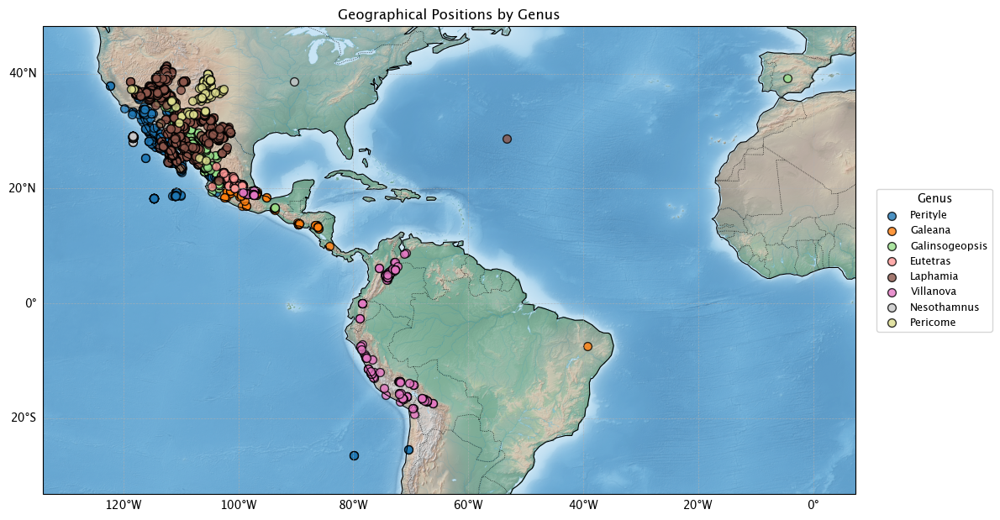

In [59]:
plot_geographical_positions(
    df_full,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


There are some clear outliers here – which we have decided have erroneous lat/lon. We have identified and marked these in the data/gbif/outliers.png image. We will keep track of all the outliers in a DataFrame so that we can address them directly with GBIF.

First, let's drop all record that have lon < 60º

In [60]:
outlier_df = df_full[df_full.decimalLongitude > -60].reset_index(drop=True)

In [61]:
# og_len = len(df_full)
# df_full = df_full[df_full.decimalLongitude < -60]
# print('Dropped', og_len - len(df_full), 'rows with lat/lon > -60')

And now there's a couple records that are too far West.

In [62]:
outlier_df = pd.concat([outlier_df, df_full[df_full.decimalLongitude < -122]]).reset_index(drop=True)

And now, one in the American midwest that has no business being there!

In [63]:
outlier_df = pd.concat([outlier_df, df_full[(df_full.decimalLatitude > 38) & (df_full.decimalLongitude > -95)]]).reset_index(drop=True)


And one off the coast of Baja in the middle of the Pacific

In [64]:
outlier_df = pd.concat([outlier_df, df_full[(df_full.decimalLatitude < 25.5) & (df_full.decimalLatitude > 24) & (df_full.decimalLongitude < -115) & (df_full.decimalLongitude > -120) & (df_full.acceptedName == 'Perityle brandegeeana')]]).reset_index(drop=True)


The other erroneous ones are a little less obvious, so we'll handle them when they come up in the following subset analysis. For now, let's remove the outlier_df rows from df_full.

In [65]:
df_full = df_full.merge(outlier_df, how='outer', indicator=True).query('_merge == "left_only"').drop(columns=['_merge']).reset_index(drop=True)


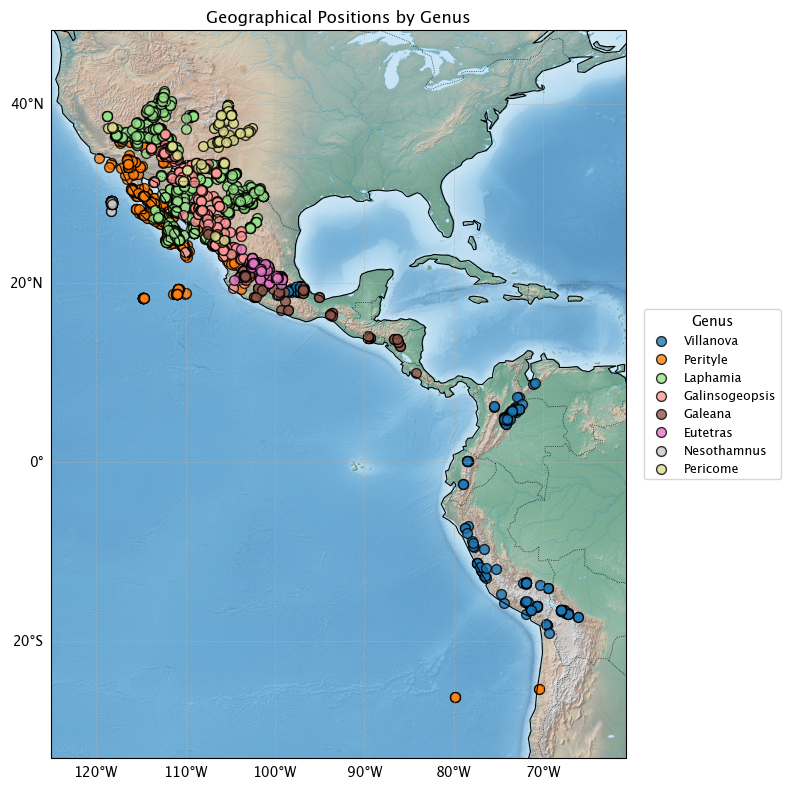

In [66]:
plot_geographical_positions(
    df_full,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


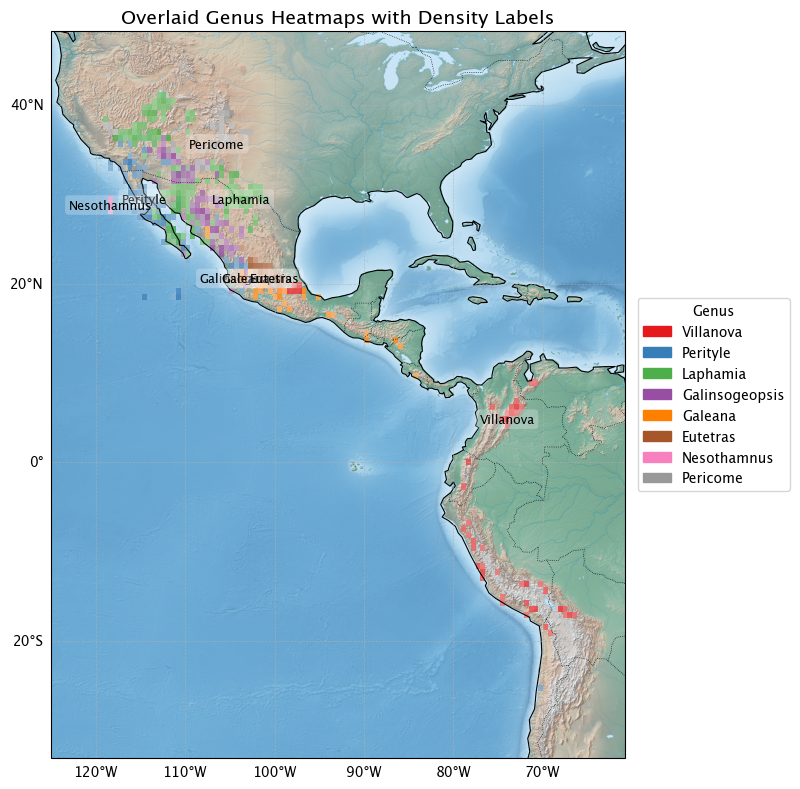

In [67]:
plot_geographical_heatmap_overlay(
    df_full,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedGenus', group_label='Genus'
)


## b. Perityle

In [68]:
perityle_df = df_full[df_full['acceptedGenus'] == 'Perityle']
print('Number of collected specimens:', len(perityle_df))
print('Species:', perityle_df['acceptedSpecies'].unique())


Number of collected specimens: 757
Species: ['carterae' 'californica' 'socorrosensis' 'emoryi' 'aurea' 'brandegeeana'
 'trichodonta' 'rosei' 'tenuifolius']


All of interest (from Nomenclator)
- Perityle aurea Rose
- Perityle brandegeeana Rose
- Perityle californica Benth.
- Perityle carterae (A.M. Powell) I.H. Lichter-Marck
- Perityle crassifolia Brandegee var. crassifolia
- Perityle crassifolia var. robusta (Rydb.) Everly
- Perityle cuneata Brandegee var. cuneata 
- Perityle cuneata var. marginata (Rydb.) I.M. Johnston 
- Perityle emoryi Torr.
- Perityle rosei Greenm.
- Perityle rotundifolia (Benth.) T.S. Brandegee
- Perityle socorrosensis Rose
- Perityle tenuifolius (Phil.) I.H. Lichter-Marck
- Perityle trichodonta S.F. Blake 

### i. All

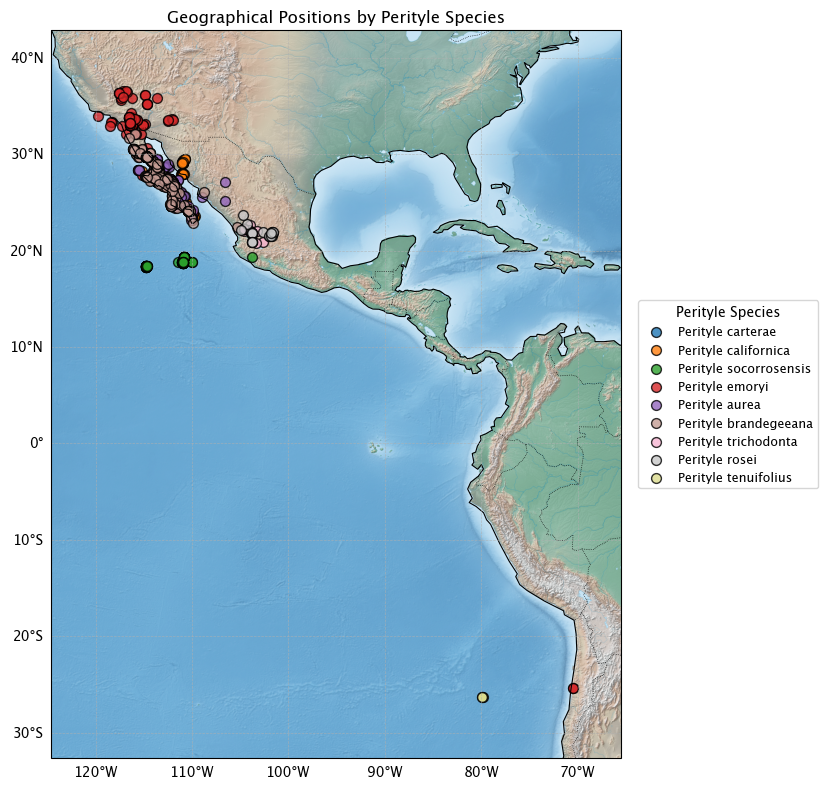

In [69]:
plot_geographical_positions(
    perityle_df,
    lat_col='decimalLatitude', 
    lon_col='decimalLongitude',
    raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species'
)


### ii. Baja, CA and SW U.S


In [70]:
perityle_subset_1 = [
'aurea', 
'brandegeeana', 
'californica', 
'carterae', 
'crassifolia', 
'crassifolia', 
'cuneata', 
'cuneata', 
'emoryi',
'rotundifolia', 
'socorrosensis']

perityle_subset_1_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_1)]

perityle_subset_1_df = perityle_subset_1_df[perityle_subset_1_df.decimalLatitude > 10]


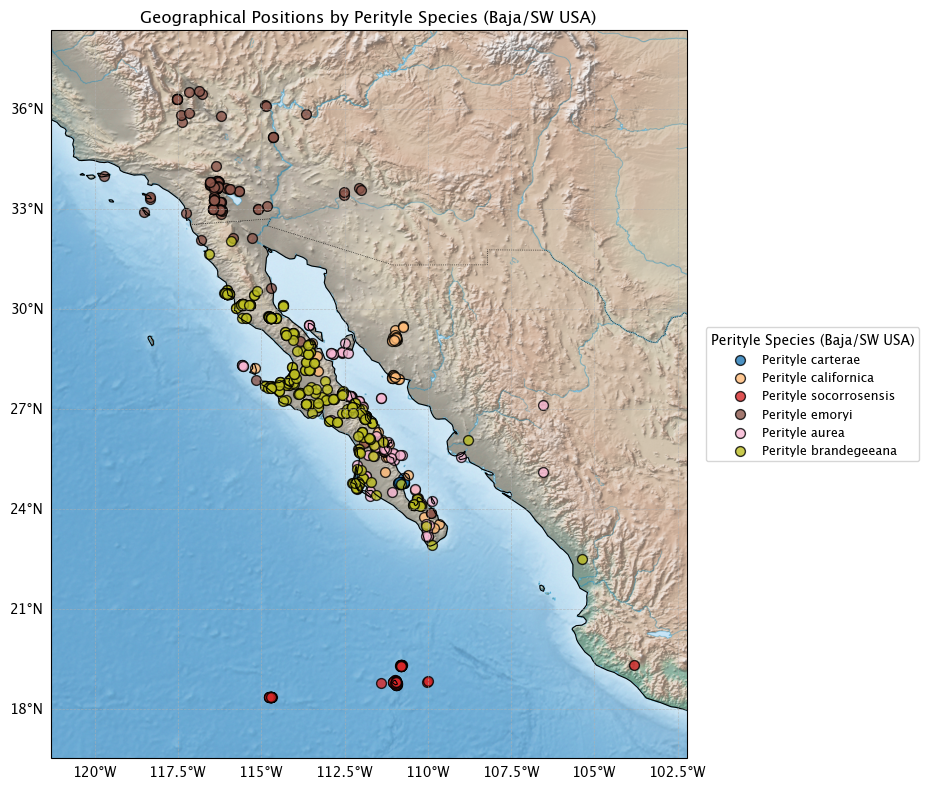

In [71]:
plot_geographical_positions(
    perityle_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Baja/SW USA)',
)


### iv. Mainland Mexico


In [72]:
perityle_subset_3 = ['rosei', 'trichodonta']

perityle_subset_3_df = perityle_df[perityle_df.acceptedSpecies.isin(perityle_subset_3)]

len(perityle_subset_3_df)

42

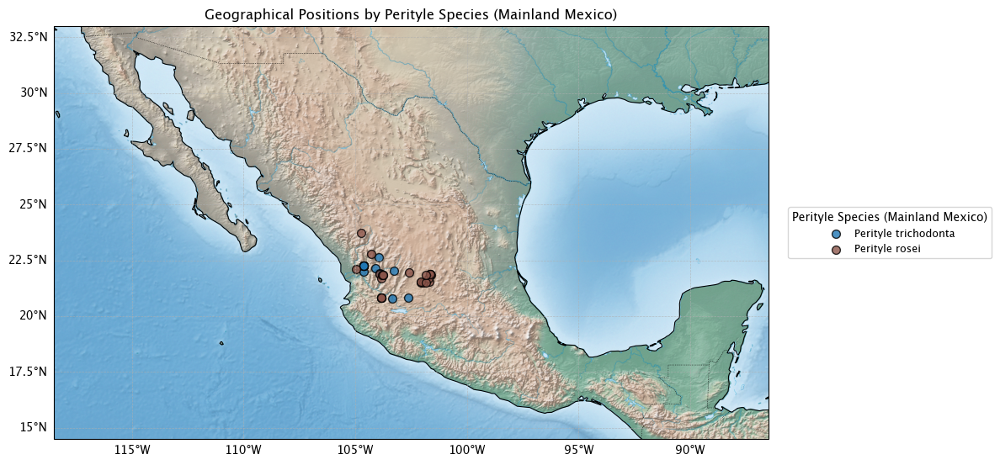

In [73]:
plot_geographical_positions(
    perityle_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Mainland Mexico)',
    bbox = [-118.5, -86.5, 14.5, 33.0]
)


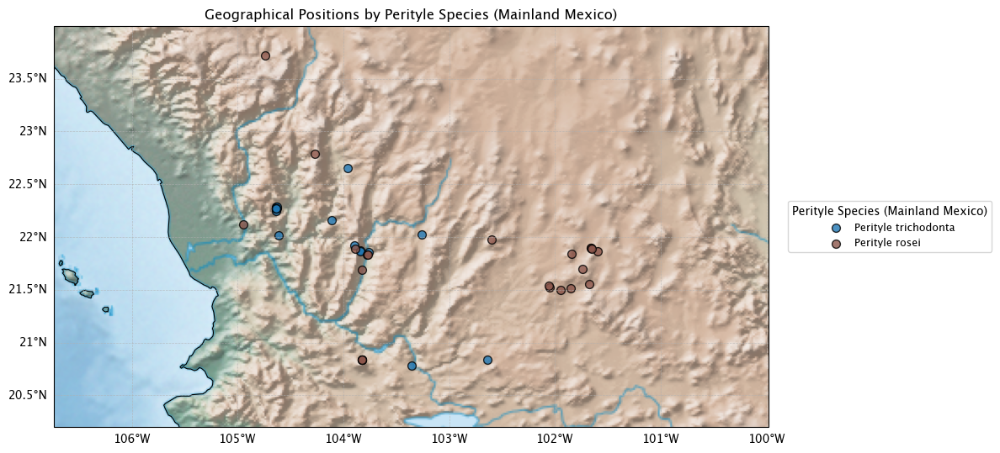

In [74]:
plot_geographical_positions(
    perityle_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Perityle Species (Mainland Mexico)',
    bbox = [-106.74,-99.98,20.2,24.0]
)


## c. Pericome

### i. All


In [75]:
pericome_df = df_full[df_full['acceptedGenus'] == 'Pericome']
print('Number of collected specimens:', len(pericome_df))
print('Species:', pericome_df['acceptedSpecies'].unique())


Number of collected specimens: 104
Species: ['macrocephala' 'caudata']


All of interest (from Nomenclator)
- Pericome caudata A. Gray
- Pericome macrocephala B.L. Rob.

In [76]:
pericome_subset_1 = ['caudata', 'macrocephala']

pericome_subset_1_df = pericome_df[pericome_df.acceptedSpecies.isin(pericome_subset_1)]

len(pericome_subset_1_df)

104

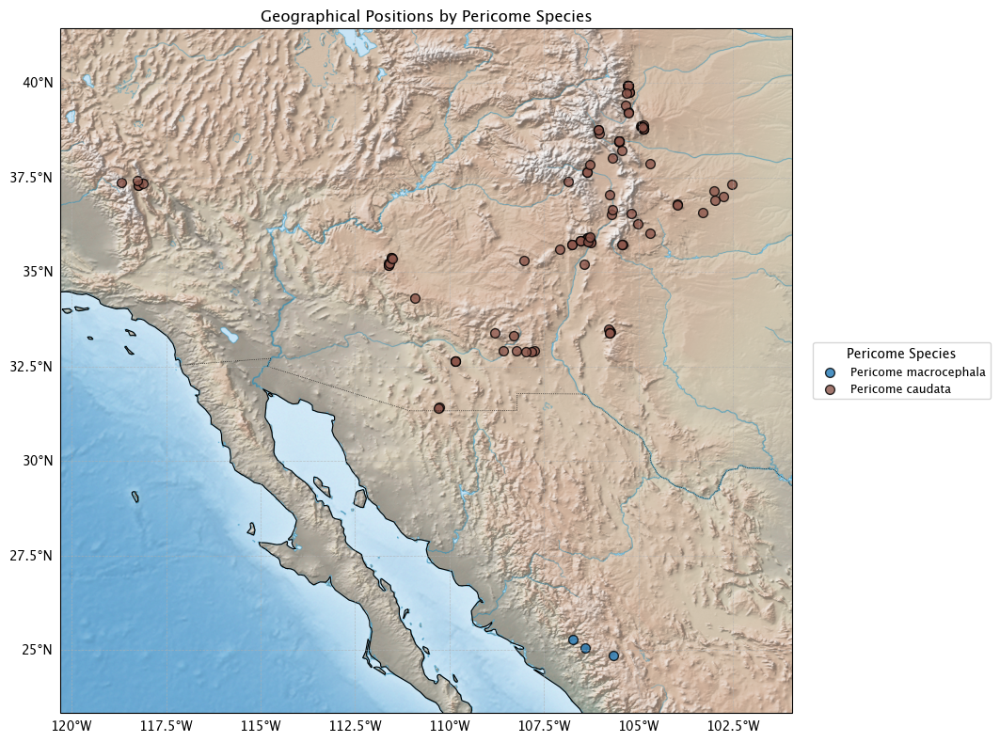

In [77]:
plot_geographical_positions(
    pericome_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Pericome Species',
    # bbox = [-118.5, -86.5, 14.5, 33.0]
)


## d. Eutetras

### i. All


In [78]:
eutetras_df = df_full[df_full['acceptedGenus'] == 'Eutetras']
print('Number of collected specimens:', len(eutetras_df))
print('Species:', eutetras_df['acceptedSpecies'].unique())


Number of collected specimens: 157
Species: ['pringlei' 'palmeri']


All of interest (from Nomenclator)
- eutetras palmeri A. Gray
- eutetras pringlei Greenm.,

In [79]:
eutetras_subset_1 = ['palmeri', 'pringlei']

eutetras_subset_1_df = eutetras_df[eutetras_df.acceptedSpecies.isin(eutetras_subset_1)]

len(eutetras_subset_1_df)

157

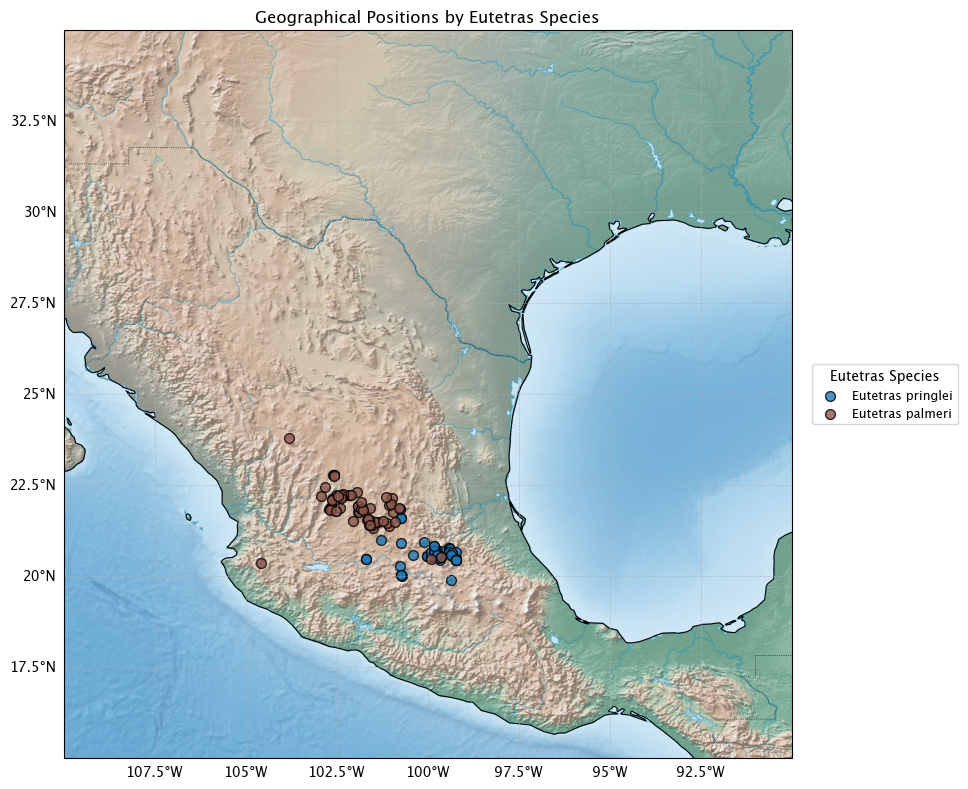

In [80]:
plot_geographical_positions(
    eutetras_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Eutetras Species',
    bbox = [-110, -90, 15, 35]
)


## e. Nesothamnus

### i. All


In [81]:
nesothamnus_df = df_full[df_full['acceptedGenus'] == 'Nesothamnus']
print('Number of collected specimens:', len(nesothamnus_df))
print('Species:', nesothamnus_df['acceptedSpecies'].unique())


Number of collected specimens: 83
Species: ['incanus']


All of interest (from Nomenclator)
- Nesothamnus incanus (A. Gray) Rydb

In [82]:
nesothamnus_subset_1 = ['incanus']

nesothamnus_subset_1_df = nesothamnus_df[nesothamnus_df.acceptedSpecies.isin(nesothamnus_subset_1)]

len(nesothamnus_subset_1_df)

83

Guadalupe Island


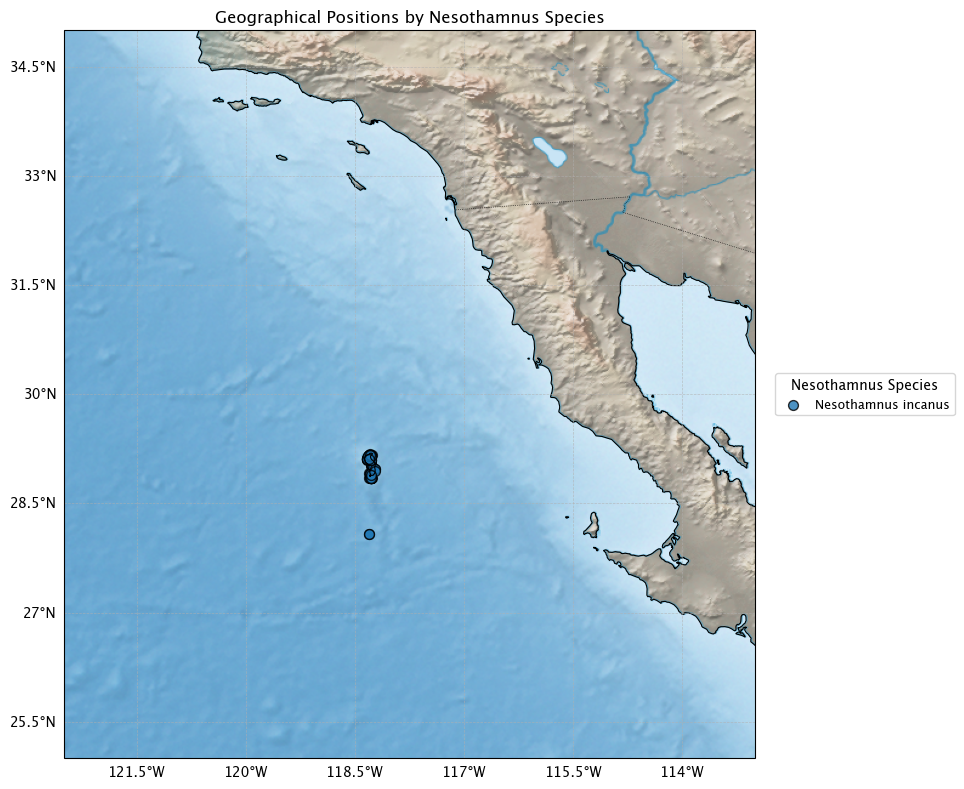

In [83]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-122.5, -113, 25, 35]
)


Looks like there's an errant latitude here!

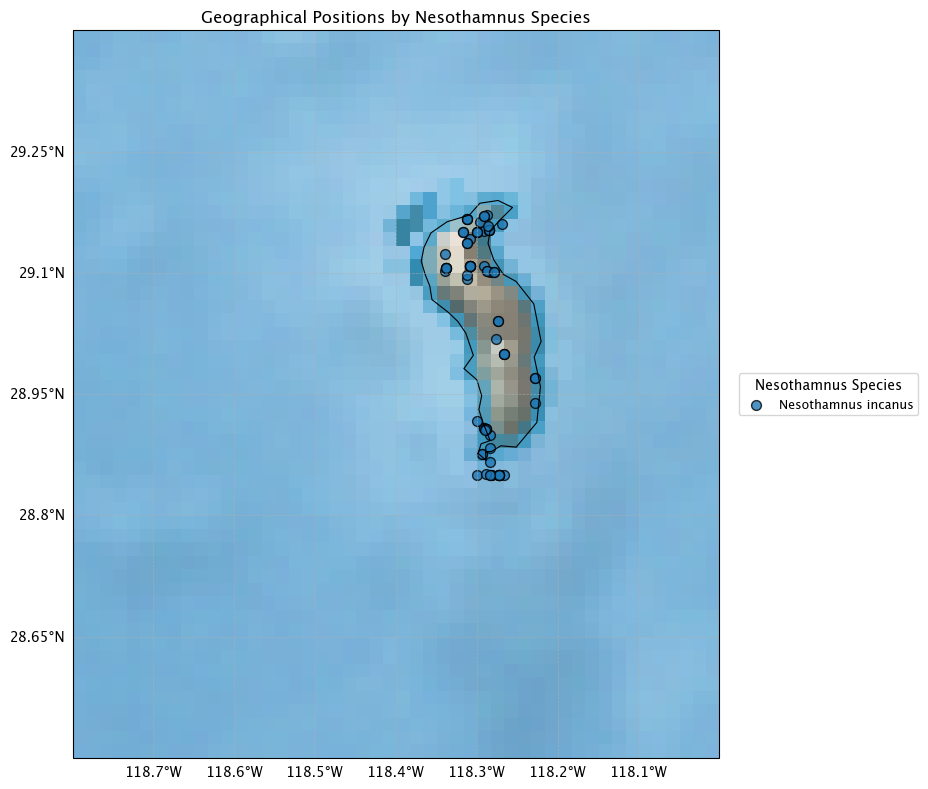

In [84]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName', group_label='Nesothamnus Species',
    bbox = [-118.8, -118, 28.5, 29.4]
)


In [85]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader as shpreader
from cartopy.io.shapereader import Reader
import matplotlib.cm as colormaps
import numpy as np
import rasterio
from rasterio.plot import show as rio_show
from matplotlib.colors import LightSource, Normalize

def plot_geographical_positions(
    df, 
    lat_col='decimallatitude_wgs', 
    lon_col='decimallongitude_wgs',
    group_col='speciesCurated',
    group_label='Species',
    zoom='auto',
    cluster_line=False,
    plot_roads=False,
    plot_rivers=False,
    raster_path=None,
    bbox=None,
    hillshade_overlay=False,
    plot_borders=True
):
    projection = ccrs.PlateCarree()
    fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': projection})

    # Filter data to only what's inside the bbox
    if bbox:
        min_lon, max_lon, min_lat, max_lat = bbox
        df = df[
            (df[lon_col] >= min_lon) & (df[lon_col] <= max_lon) &
            (df[lat_col] >= min_lat) & (df[lat_col] <= max_lat)
        ]

    if df.empty:
        print("No data inside bounding box. Nothing to plot.")
        return

    # Raster background
    if raster_path:
        with rasterio.open(raster_path) as src:
            if hillshade_overlay:
                elevation = src.read(1)
                # elevation = np.where(elevation == src.nodata, np.nan, elevation)

                # Compute hillshade
                ls = LightSource(azdeg=315, altdeg=45)
                cmap = plt.cm.Blues_r  # Or cmocean.cm.deep if installed
                shaded = ls.shade(elevation, cmap=cmap, vert_exag=1, blend_mode='overlay')

                ax.imshow(
                    shaded,
                    extent=[src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top],
                    transform=ccrs.PlateCarree(),
                    origin='upper'
                )
            else:
                rio_show(src, ax=ax, transform=src.transform)

    if plot_borders:
        # Base map features
        ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
        ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=0.5)
        ax.add_feature(cfeature.LAND, edgecolor='black', alpha=0.3)
        ax.add_feature(cfeature.OCEAN, alpha=0.3)
        

    if plot_rivers:
        ax.add_feature(cfeature.RIVERS, edgecolor='blue', alpha=0.7, linewidth=0.5)
    if plot_roads:
        roads_shp = shpreader.natural_earth(category='cultural', name='roads', resolution='10m')
        roads = Reader(roads_shp).geometries()
        ax.add_geometries(roads, crs=projection, edgecolor='brown', facecolor='none', linewidth=0.5, alpha=0.7)

    # Color by group
    group_list = df[group_col].dropna().unique()
    cmap = colormaps.get_cmap('tab20')
    color_map = {group: cmap(i / len(group_list)) for i, group in enumerate(group_list)}

    for group in group_list:
        subset = df[df[group_col] == group]
        ax.scatter(
            subset[lon_col], subset[lat_col],
            color=color_map[group],
            s=50, alpha=0.8, edgecolor='k',
            label=group,
            transform=ccrs.PlateCarree()
        )

        if cluster_line and len(subset) > 1:
            subset = subset.sort_values(by=[lat_col, lon_col])
            for i in range(len(subset) - 1):
                ax.plot(
                    [subset.iloc[i][lon_col], subset.iloc[i + 1][lon_col]],
                    [subset.iloc[i][lat_col], subset.iloc[i + 1][lat_col]],
                    color=color_map[group],
                    linewidth=1.5, alpha=0.6,
                    transform=ccrs.PlateCarree()
                )

    # Set extent
    if bbox:
        ax.set_extent(bbox, crs=projection)
    else:
        min_lat, max_lat = df[lat_col].min(), df[lat_col].max()
        min_lon, max_lon = df[lon_col].min(), df[lon_col].max()
        lat_buffer = (max_lat - min_lat) * 0.1 if max_lat > min_lat else 1
        lon_buffer = (max_lon - min_lon) * 0.1 if max_lon > min_lon else 1
        extent = [min_lon - lon_buffer, max_lon + lon_buffer, min_lat - lat_buffer, max_lat + lat_buffer]
        ax.set_extent(extent, crs=projection)

    # Gridlines
    gl = ax.gridlines(draw_labels=True, linestyle='--', linewidth=0.5, alpha=0.7)
    gl.top_labels = False
    gl.right_labels = False
    gl.xlabel_style = {'size': 10}
    gl.ylabel_style = {'size': 10}

    ax.set_title(f'Geographical Positions by {group_label}')
    ax.legend(
        loc='center left',
        bbox_to_anchor=(1.02, 0.5),
        fontsize=9,
        title=group_label,
        frameon=True
    )

    plt.tight_layout()
    plt.show()


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_63050/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


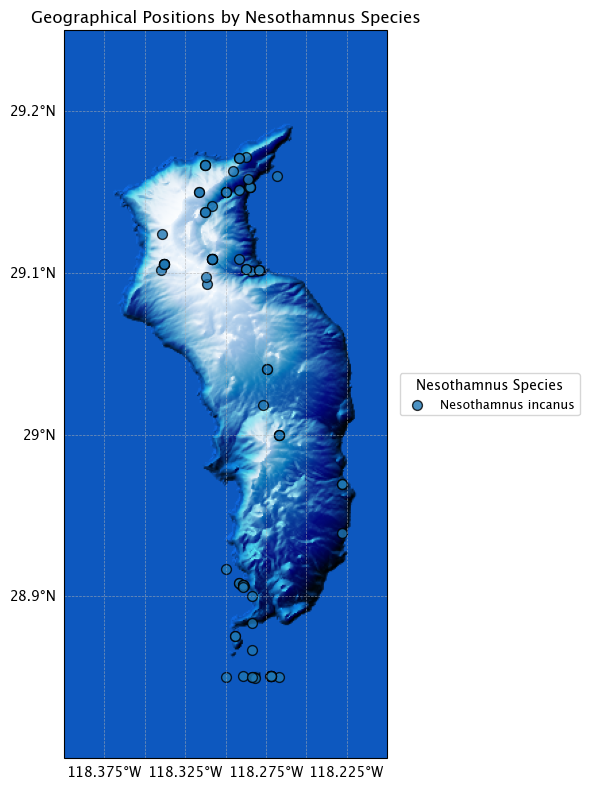

In [86]:
plot_geographical_positions(
    nesothamnus_subset_1_df,
    lat_col='decimalLatitude',
    lon_col='decimalLongitude',
    raster_path='../data/guadalupe/output_SRTMGL3.tif',
    hillshade_overlay=True, 
    plot_borders=False,
    group_col='acceptedName',
    group_label='Nesothamnus Species',
    bbox=[-118.4, -118.2, 28.8, 29.25]
)


In [87]:
nesothamnus_subset_1_df

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType,acceptedName,acceptedGenus,acceptedSpecies
89,1259881876,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
153,1426446795,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
154,1426446820,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
155,1453085170,PRESENT,5693137,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
305,1893404112,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2496,4168461386,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
2497,4168461600,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
2512,4168585687,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus
2884,4856465572,PRESENT,3146381,6,7707728,220,414,3065,7336287,5693137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Nesothamnus incanus,Nesothamnus,incanus


In [88]:
# plot_3d_relief_with_species(
#     tif_path='../data/guadalupe/output_SRTMGL3.tif',
#     group_col='acceptedName',
#     group_label='Nesothamnus Species',
#     lat_col='decimalLatitude',      lon_col='decimalLongitude',         
#     bbox = [-118.4, -118.2, 28.8, 29.25], #    bbox=[-119, -111, 35, 42],
#     df=nesothamnus_subset_1_df,
#     elev_exaggeration=0.00005,
#     point_size=25.0,
#     lift_above_surface=0.01,
#     surface_patch_scale=15.0,
#     colormap='gist_earth'
    
# )


## f. Galinsogeopsis

### i. All

Number of collected specimens: 491
Species: ['turneri' 'pseudociliata' 'vigilans' 'jaliscana' 'harkerae' 'canescens'
 'microcephala' 'coronopifolia' 'hofmeisteria' 'montana' 'feddemae'
 'ciliata' 'glaucescens' 'lineariloba' 'scopulorum']


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_63050/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


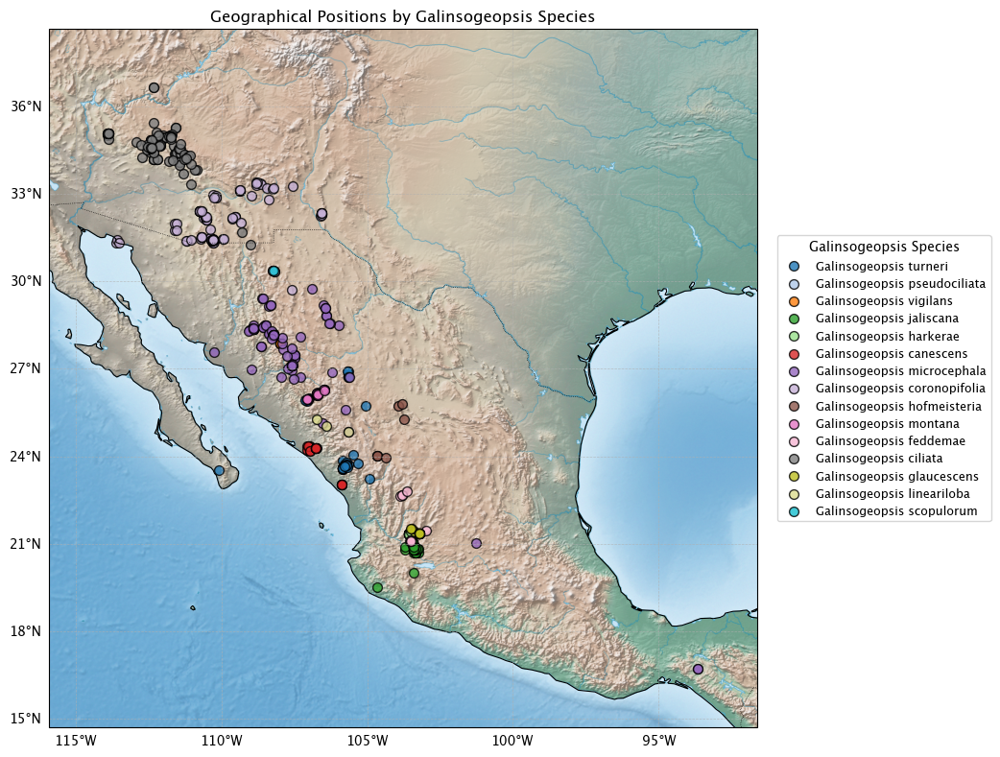

In [89]:
galinsogeopsis_df = df_full[df_full['acceptedGenus'] == 'Galinsogeopsis']
print('Number of collected specimens:', len(galinsogeopsis_df))
print('Species:', galinsogeopsis_df['acceptedSpecies'].unique())

plot_geographical_positions(
    galinsogeopsis_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species'
)


### ii. Widespread

No data inside bounding box. Nothing to plot.


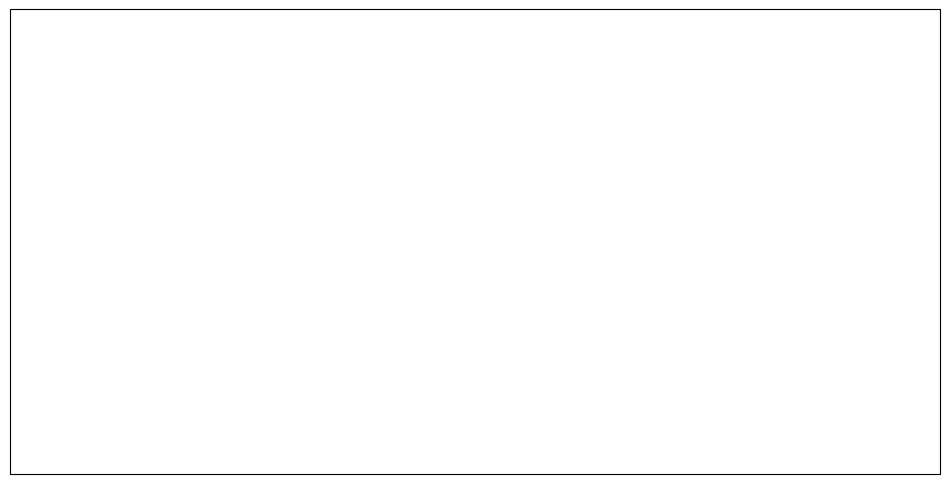

In [90]:
gali_subset_1 = ['microglossa', 'microglossa']  # covers both varieties
# gali_subset_1 = ['spilanthoides'] # microglossa won't show anything bc new name, use spilanthoides instead
gali_subset_1_df = galinsogeopsis_df[galinsogeopsis_df['acceptedSpecies'].isin(gali_subset_1)]

plot_geographical_positions(
    gali_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species (Widespread)'
)


### iii. Isolated

In [91]:
gali_subset_2 = [
    'canescens', 'ciliata', 'coronopifolia', 'feddemae', 'glaucescens', 'harkerae', 'hofmeisteria',
    'jaliscana', 'lineariloba', 'microcephala', 'montana', 'pseudociliata', 'scopulorum',
    'turneri', 'vigilans'
]
gali_subset_2_df = galinsogeopsis_df[galinsogeopsis_df['acceptedSpecies'].isin(gali_subset_2)]

plot_geographical_positions(
    gali_subset_2_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    plot_rivers=False,
    group_col='acceptedName',
    group_label='Galinsogeopsis Species (Isolated)'
)


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_63050/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


KeyboardInterrupt: 

## g. Laphamia

### i. All

In [ ]:

laphamia_subset_1 = ['reinana', 'leptoglossa', 'cordifolia', 'sanchezii', 'lobata', 'gentryi', 'batopilensis', 'lloydii']
laphamia_subset_2 = ['parryi', 'vaseyi', 'aglossa']
laphamia_subset_3 = ['rupestris', 'cinerea', 'fosteri', 'quinqueflora', 'castillonii',
                     'bisetosa', 'cernua', 'huecoensis', 'warnockii']
laphamia_subset_4 = [
    'dissecta', 'cochisensis', 'angustifolia', 'lindheimeri', 'staurophylla', 'vandevenderi',
    'lemmonii', 'ambrosiifolia', 'gilensis', 'coahuilensis', 'saxicola'
]
laphamia_subset_5 = [
    'congesta', 'stansburyi', 'tenella', 'specuicola', 'gracilis', 'intricata',
    'megalocephala', 'villosa', 'inyoensis'
]

laphamia_clade_d = {
    'Sonora/Sinaloa + Baja clade': laphamia_subset_1,
    'Big Bend clade': laphamia_subset_2,
    'Western Texas Sky Island clade': laphamia_subset_3,
    'AZ/New Mexico Sky Island clade': laphamia_subset_4,
    'Great Basin clade': laphamia_subset_5
}




In [ ]:
laphamia_df = df_full[df_full['acceptedGenus'] == 'Laphamia']
print('Number of collected specimens:', len(laphamia_df))
print('Species:', laphamia_df['acceptedSpecies'].unique())

laphamia_df['clade'] = laphamia_df['acceptedSpecies'].map(lambda x: [k for k, v in laphamia_clade_d.items() if x in v][0] if x in sum(laphamia_clade_d.values(), []) else 'Unknown')

Number of collected specimens: 1832
Species: ['reinana' 'carmenensis' 'megalocephala' 'sanchezii' 'leptoglossa'
 'cordifolia' 'vaseyi' 'lobata' 'lloydii' 'aglossa' 'bisetosa'
 'staurophylla' 'parryi' 'coahuilensis' 'castillonii' 'gentryi'
 'vandevenderi' 'inyoensis' 'villosa' 'lemmonii' 'gilensis' 'batopilensis'
 'stansburyi' 'huecoensis' 'toumeyi' 'intricata' 'dissecta' 'angustifolia'
 'warnockii' 'rupestris' 'cinerea' 'cernua' 'fosteri' 'specuicola'
 'gracilis' 'vitreomontana' 'quinqueflora' 'ambrosiifolia' 'cochisensis'
 'grandifolia' 'ajoensis' 'lindheimeri']


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/642416918.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  laphamia_df['clade'] = laphamia_df['acceptedSpecies'].map(lambda x: [k for k, v in laphamia_clade_d.items() if x in v][0] if x in sum(laphamia_clade_d.values(), []) else 'Unknown')


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


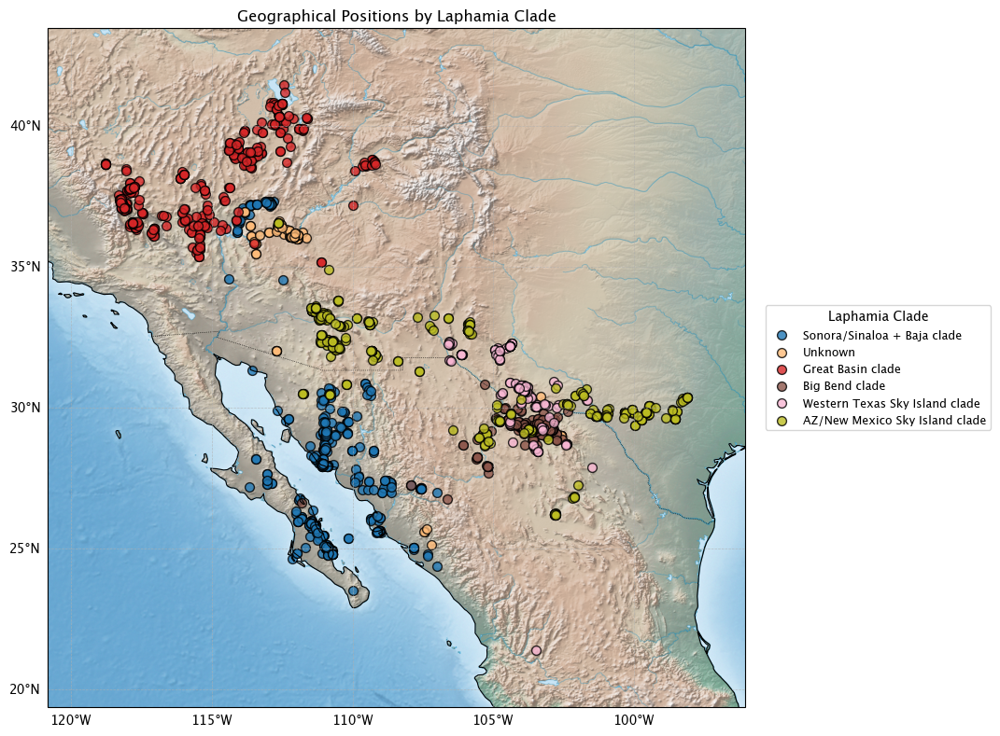

In [ ]:
plot_geographical_positions(
    laphamia_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='clade',
    group_label='Laphamia Clade'
)


### ii. Sonora/Sinaloa + Baja California

In [ ]:
nomenclator.lookup('Laphamia palmeri')

{'scientific_name': 'Laphamia palmeri',
 'genus': 'Laphamia',
 'species': 'palmeri',
 'authors': 'var. tenella M.E. Jones',
 'accepted_name': 'Laphamia palmeri',
 'accepted_authors': 'A. Gray',
 'relationship': 'synonym'}

/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


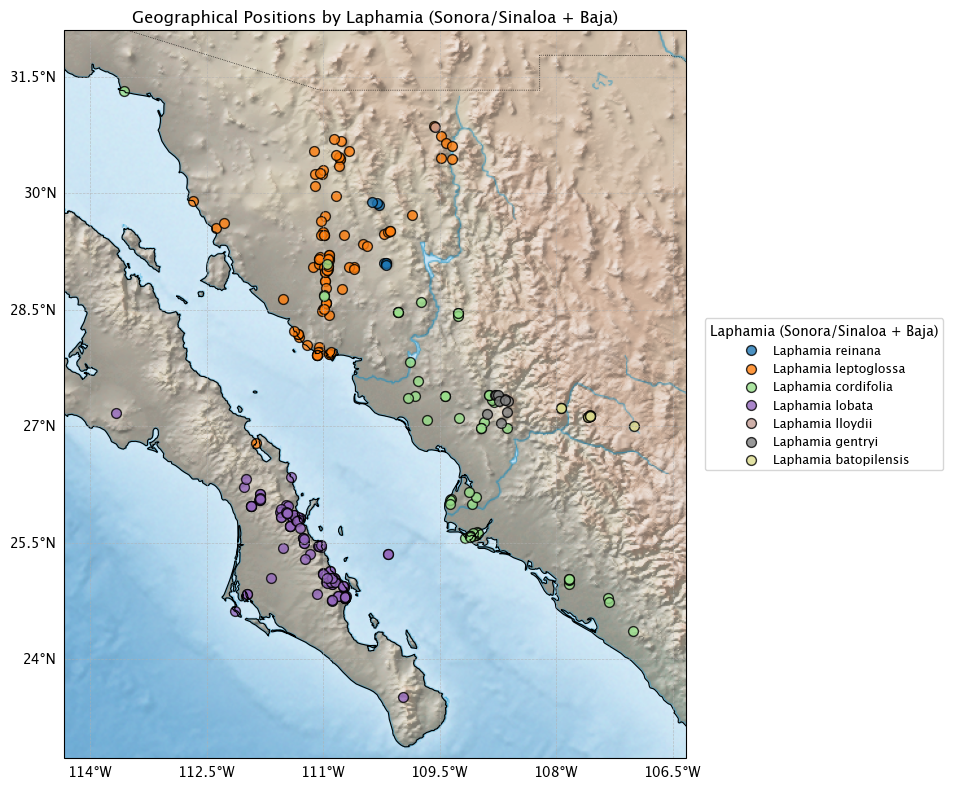

In [ ]:
laphamia_subset_1 = ['reinana', 'leptoglossa', 'cordifolia', 'lobata', 'gentryi', 'batopilensis', 'lloydii']
laphamia_subset_1_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_1)]

# Filter out ones in US
laphamia_subset_1_df = laphamia_subset_1_df[laphamia_subset_1_df['decimalLatitude'] < 32]
laphamia_subset_1_df = laphamia_subset_1_df[laphamia_subset_1_df['decimalLongitude'] < -104]

plot_geographical_positions(
    laphamia_subset_1_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Sonora/Sinaloa + Baja)'
)


### iii. Big Bend Region

/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


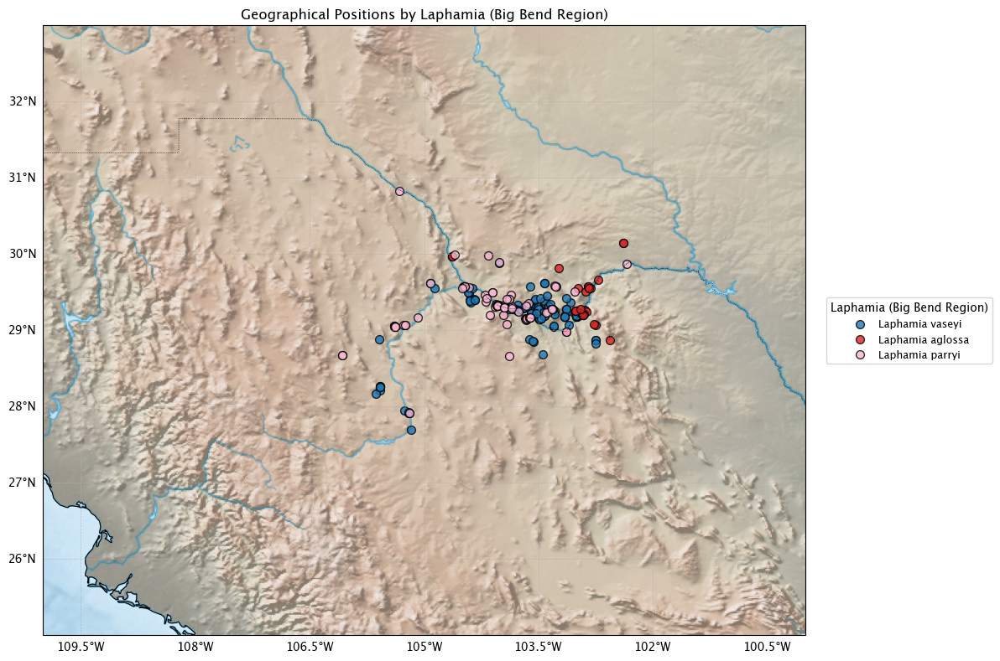

In [ ]:
laphamia_subset_2 = ['parryi', 'vaseyi', 'aglossa']
laphamia_subset_2_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_2)]

# Filter out 
laphamia_subset_2_df = laphamia_subset_2_df[laphamia_subset_2_df['decimalLatitude'] > 27]
laphamia_subset_2_df = laphamia_subset_2_df[laphamia_subset_2_df['decimalLongitude'] > -107]

plot_geographical_positions(
    laphamia_subset_2_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Big Bend Region)',
    bbox = [-110, -100, 25, 33.0]
)


### iv. Western Texas Sky Islands

/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


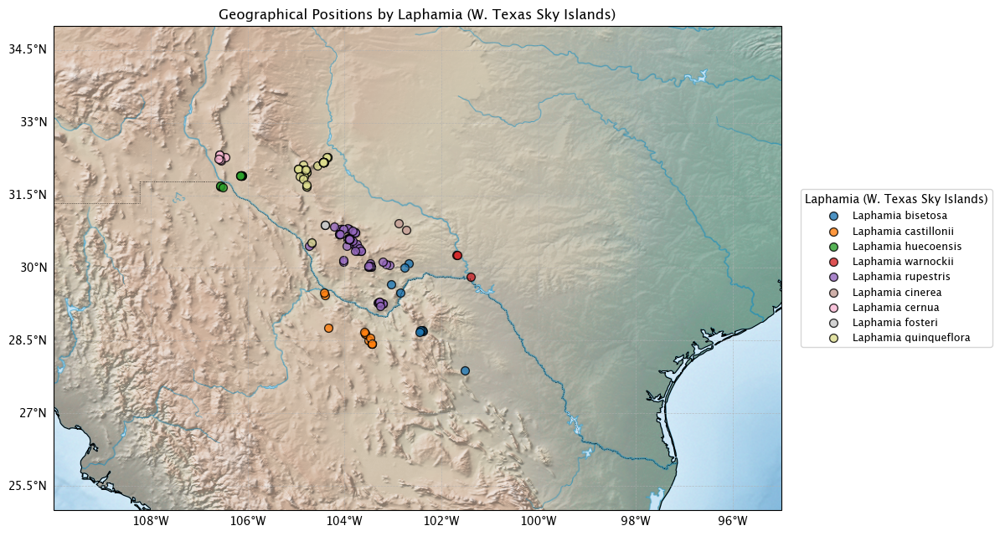

In [ ]:
laphamia_subset_3 = ['rupestris', 'cinerea', 'fosteri', 'quinqueflora', 'castillonii',
                     'bisetosa', 'cernua', 'huecoensis', 'warnockii']
laphamia_subset_3_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_3)]

# Filter out 
laphamia_subset_3_df = laphamia_subset_3_df[laphamia_subset_3_df['decimalLatitude'] > 24]
# laphamia_subset_3_df = laphamia_subset_3_df[laphamia_subset_3_df['decimalLongitude'] > -107]


plot_geographical_positions(
    laphamia_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (W. Texas Sky Islands)',
    bbox=[-110, -95, 25, 35.0]
)


/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


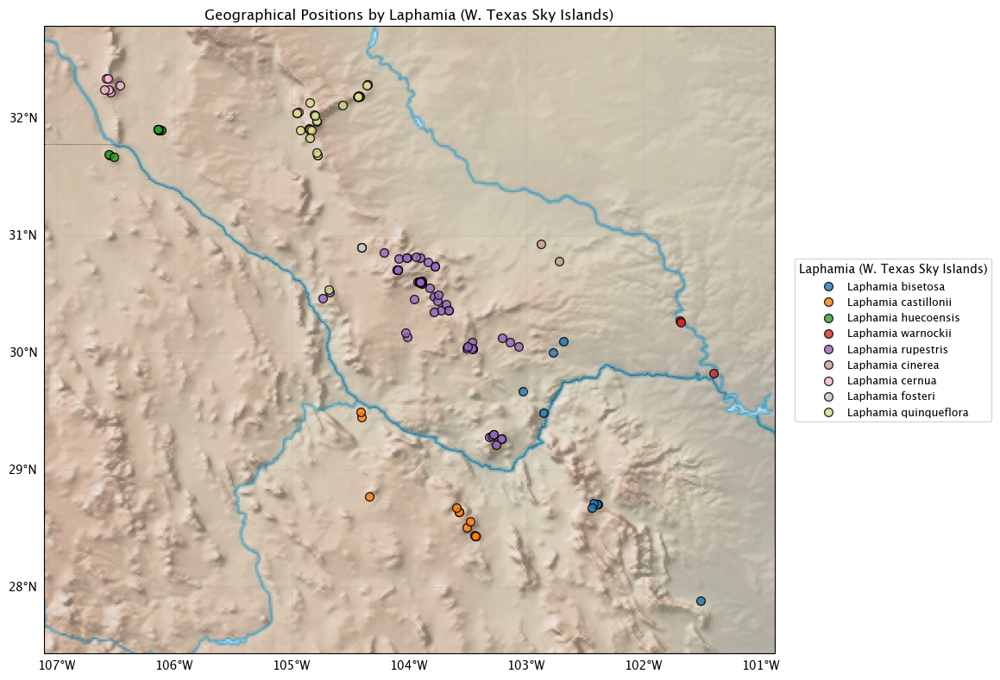

In [ ]:
plot_geographical_positions(
    laphamia_subset_3_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (W. Texas Sky Islands)'
)


### v. AZ/New Mexico Sky Islands

/var/folders/qx/bpj16cl90cq20swjd4j79cdh0000gn/T/ipykernel_33810/3023505656.py:80: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = colormaps.get_cmap('tab20')


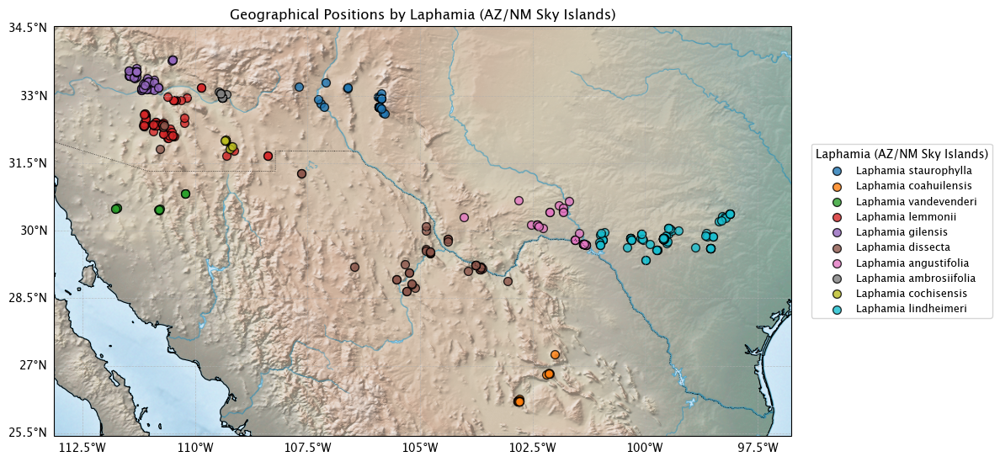

In [ ]:
laphamia_subset_4 = [
    'dissecta', 'cochisensis', 'angustifolia', 'lindheimeri', 'staurophylla', 'vandevenderi',
    'lemmonii', 'ambrosiifolia', 'gilensis', 'coahuilensis', 'saxicola'
]
laphamia_subset_4_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_4)]

# Filter out 
laphamia_subset_4_df = laphamia_subset_4_df[laphamia_subset_4_df['decimalLatitude'] < 34]
# laphamia_subset_4_df = laphamia_subset_4_df[laphamia_subset_4_df['decimalLongitude'] > -107]


plot_geographical_positions(
    laphamia_subset_4_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (AZ/NM Sky Islands)'
)


### vi. Great Basin Clade

In [ ]:
missing_species_l = ['Laphamia toumeyi', 'Laphamia congesta', 'Perityle congesta', 'Laphamia palmeri', 'Perityle tenella']

df_full[df_full['acceptedSpecies'].isin(missing_species_l)]

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType,acceptedName,acceptedGenus,acceptedSpecies


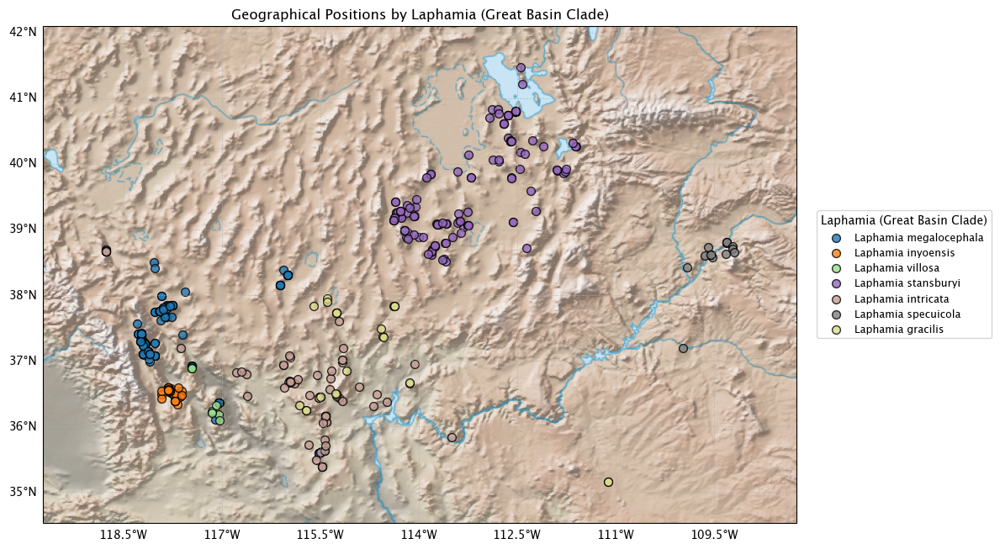

In [ ]:
laphamia_subset_5 = [
    'congesta', 'stansburyi', 'tenella', 'specuicola', 'gracilis', 'intricata',
    'megalocephala', 'villosa', 'inyoensis'
]
laphamia_subset_5_df = laphamia_df[laphamia_df['acceptedSpecies'].isin(laphamia_subset_5)]

plot_geographical_positions(
    laphamia_subset_5_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)


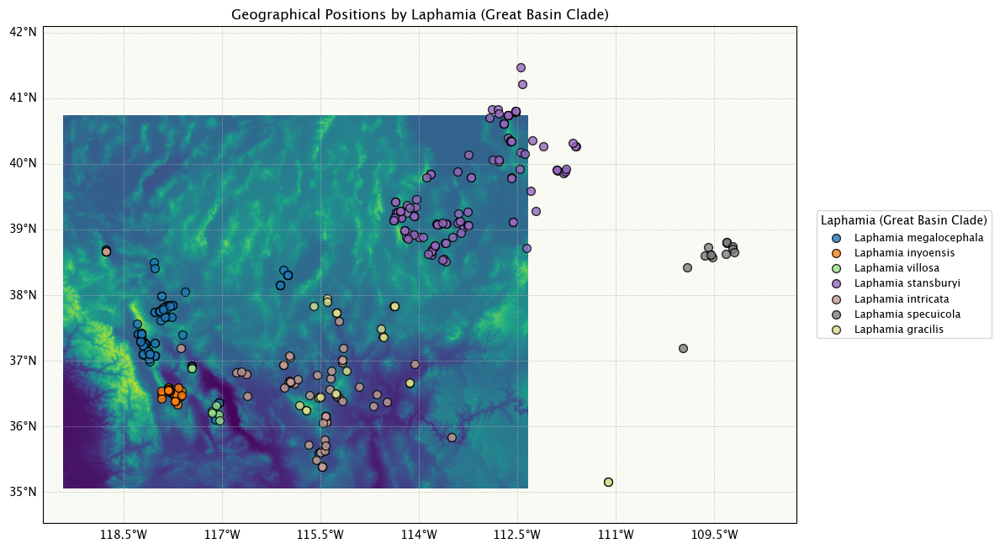

In [ ]:
plot_geographical_positions(
    laphamia_subset_5_df,
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/great_basin/output_be.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)

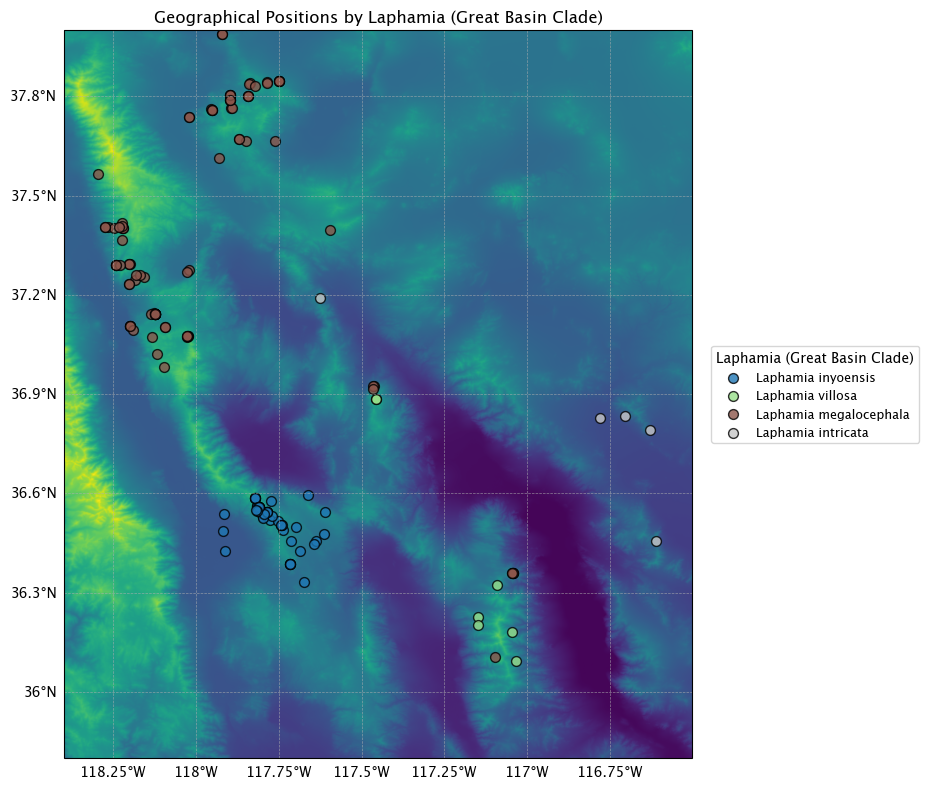

In [ ]:
plot_geographical_positions(
    laphamia_subset_5_df,
    bbox=[-118.4, -116.5, 35.8, 38],
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/great_basin/output_be.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)

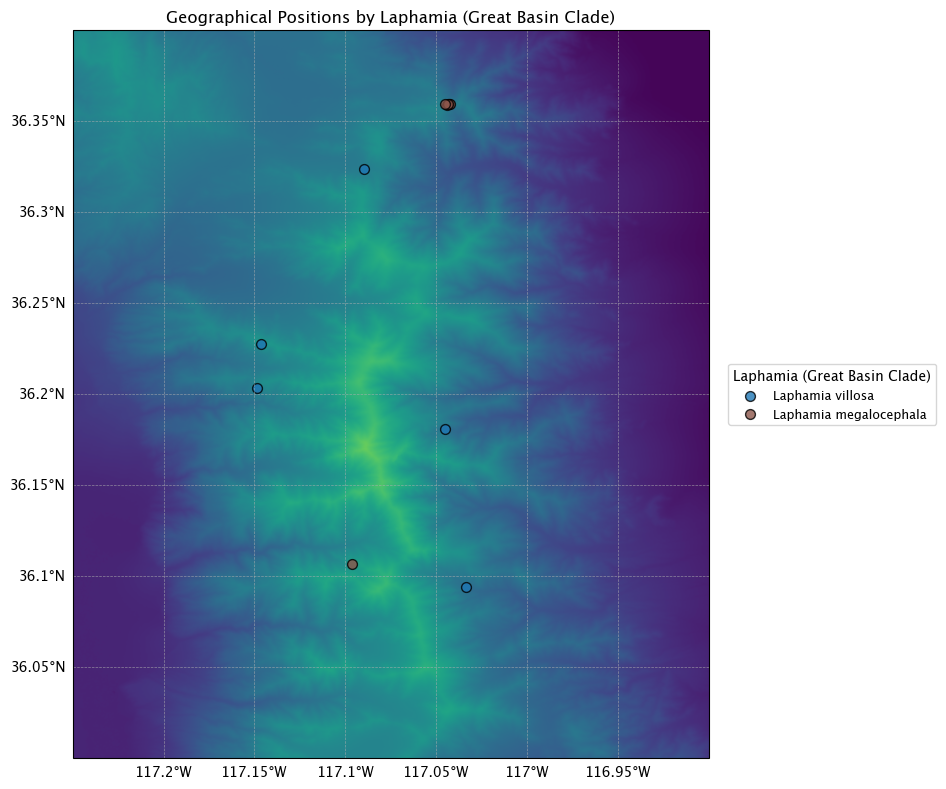

In [ ]:
plot_geographical_positions(
    laphamia_subset_5_df,
    bbox=[-117.25, -116.9, 36, 36.4],
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     raster_path='../data/great_basin/output_be.tif',
    group_col='acceptedName',
    group_label='Laphamia (Great Basin Clade)'
)

In [ ]:
plot_3d_relief_with_species(
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     tif_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    bbox=[-119, -111, 35, 42],
    df=laphamia_subset_5_df,
    elev_exaggeration=0.0008,
    point_size=15.0,
    lift_above_surface=0.05,
    surface_patch_scale=5.0,
    colormap='gist_earth',
    group_col='acceptedName',
    group_label='Great Basin Laphamia Species',
    
)


Widget(value='<iframe src="http://localhost:62141/index.html?ui=P_0x2a8cefc50_1&reconnect=auto" class="pyvista…

In [ ]:
plot_3d_relief_with_species(
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     tif_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    bbox=[-118.4, -116.5, 35.8, 38],
    df=laphamia_subset_5_df,
    elev_exaggeration=0.0004,
    point_size=15.0,
    lift_above_surface=0.05,
    surface_patch_scale=5.0,
    colormap='gist_earth',
    group_col='acceptedName',
    group_label='Great Basin Laphamia Species',
    
)

Widget(value='<iframe src="http://localhost:62141/index.html?ui=P_0x2a8cedd10_2&reconnect=auto" class="pyvista…

In [ ]:
inyo_df = df_full[df_full['acceptedName'] == 'Laphamia inyoensis']

inyo_df

,key,occurrenceStatus,taxonKey,kingdomKey,phylumKey,classKey,orderKey,familyKey,genusKey,speciesKey,...,fieldNotes,locationRemarks,eventRemarks,organismName,verbatimIdentification,organismQuantity,organismQuantityType,acceptedName,acceptedGenus,acceptedSpecies
164,1426152742,PRESENT,3146445,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
165,1426168482,PRESENT,3146445,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1216,2422323419,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1231,2422417282,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1264,2430071245,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1265,2430082372,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1271,2430192657,PRESENT,3146445,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1272,2430235731,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1275,2430278008,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis
1280,2430353222,PRESENT,3146444,6,7707728,220,414,3065,3095524,3146445.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Laphamia inyoensis,Laphamia,inyoensis


In [ ]:

plot_3d_relief_with_species(
    lat_col='decimalLatitude',      lon_col='decimalLongitude',     tif_path='../data/HYP_HR_SR_OB_DR/HYP_HR_SR_OB_DR.tif',
    bbox=[-117.5, -117.9, 36.4, 36.9],
    df=inyo_df,
    elev_exaggeration=0.0004,
    point_size=15.0,
    lift_above_surface=0.05,
    surface_patch_scale=5.0,
    colormap='gist_earth',
    group_col='acceptedName',
    group_label='Great Basin Laphamia Species',
    
)

No points inside bounding box. Only surface will be plotted.


Widget(value='<iframe src="http://localhost:62141/index.html?ui=P_0x289a53390_3&reconnect=auto" class="pyvista…